# SV and DU test results of the short-reads mouse CBS sample

In [1]:
import torch
import numpy as np
from scipy.io import mmread
from scipy.stats import spearmanr, chisquare, chi2_contingency
import pandas as pd
import itertools
import matplotlib.pyplot as plt
from plotnine import *

import scanpy as sc

from isosde.utils import get_cov_sp, counts_to_ratios, load_visium_sp_meta

In [2]:
data_dir = "/Users/jysumac/Projects/SPLISOSM_paper/data/visium_mouse_cbs/"
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"
date = '1119'

## Spatial variablility (SV) tests

### Load SV test results

In [3]:
df_sv_cbs = pd.read_csv(f"{res_dir}/sv_results/cbs_peak_sv_combined_{date}.csv", index_col=0)

# define significant events
df_sv_cbs['is_trend_svs'] = df_sv_cbs['padj_hsic-ir'] < 0.01
df_sv_cbs['is_trend_sve'] = df_sv_cbs['padj_hsic-gc'] < 0.01
df_sv_cbs['is_trend_expressed'] = df_sv_cbs['count_avg'] > 0.5

df_sv_cbs.groupby(['is_trend_expressed', 'is_trend_svs', 'is_trend_sve']).size()

is_trend_expressed  is_trend_svs  is_trend_sve
False               False         False             29
                                  True            1061
                    True          False              1
                                  True             137
True                False         False              1
                                  True            1632
                    True          True             677
dtype: int64

### Compare SV test p-values

#### Within the short-reads sample

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


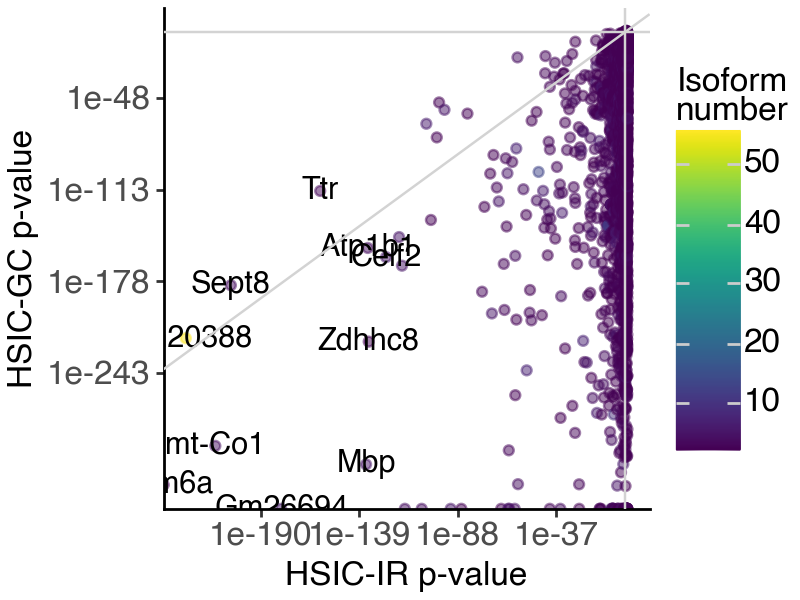

In [4]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ir', y = 'pvalue_hsic-gc')) +
        geom_point(aes(color = 'n_iso'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_hsic-ir').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IR p-value', y = 'HSIC-GC p-value', color = 'Isoform\nnumber') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


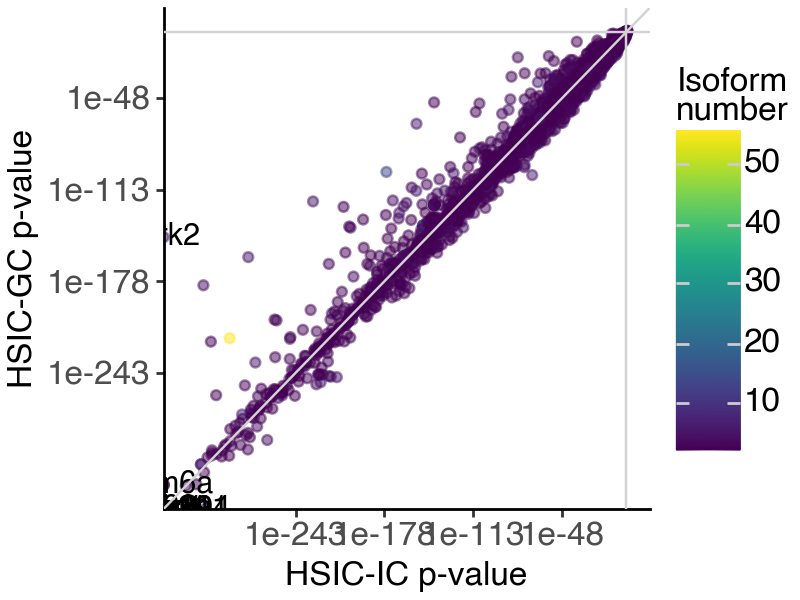

In [5]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-ic', y = 'pvalue_hsic-gc')) +
        geom_point(aes(color = 'n_iso'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_hsic-ic').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IC p-value', y = 'HSIC-GC p-value', color = 'Isoform\nnumber') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


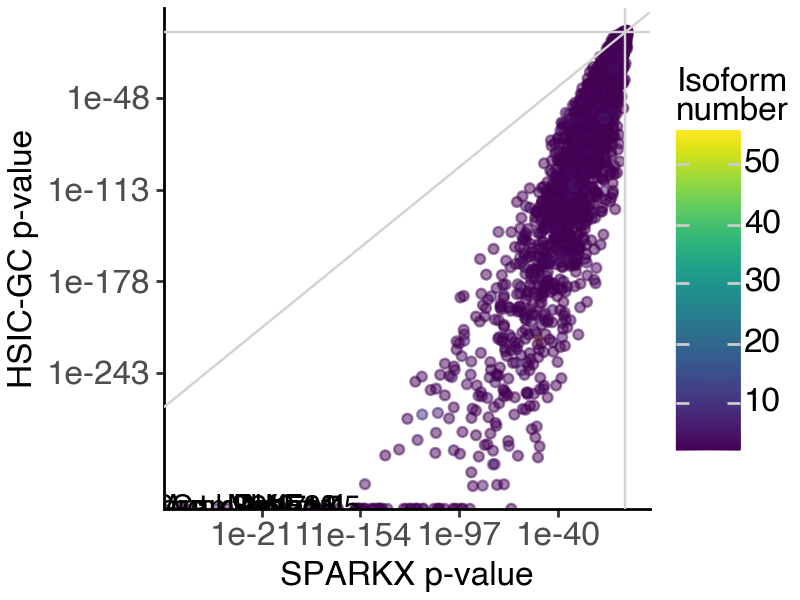

In [6]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_spark-x', y = 'pvalue_hsic-gc')) +
        geom_point(aes(color = 'n_iso'), alpha = 0.5) + 
        geom_text(
            _df.nsmallest(10, 'pvalue_spark-x').reset_index(),
            aes(label = 'gene_symbol')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'SPARKX p-value', y = 'HSIC-GC p-value', color = 'Isoform\nnumber') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[4,3],
             text=element_text(size = 12))
)

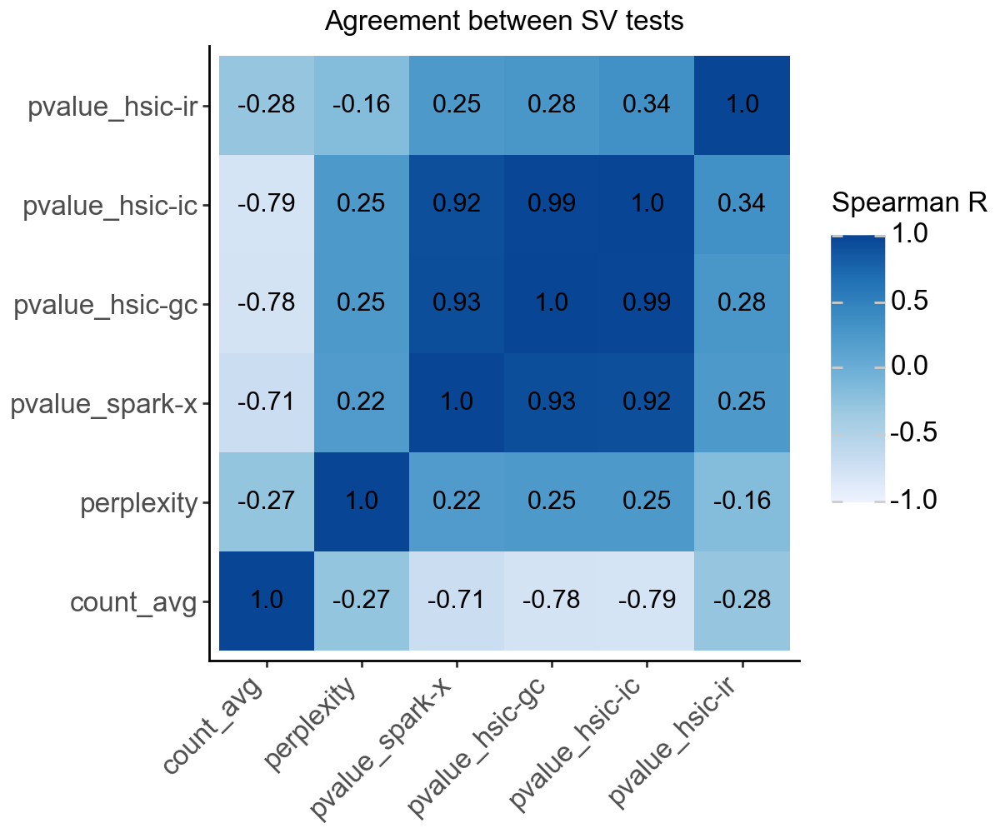

In [7]:
# _df = df_sv_cbs.loc[
#     df_sv_cbs['is_trend_expressed'], 
#     ['count_avg', 'perplexity', 'pvalue_hsic-ir', 'pvalue_hsic-ic', 'pvalue_hsic-gc', 'pvalue_spark-x']
# ]
_df = df_sv_cbs.loc[:, ['count_avg', 'perplexity', 'pvalue_hsic-ir', 'pvalue_hsic-ic', 'pvalue_hsic-gc', 'pvalue_spark-x']]
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0], 
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

_order = ['count_avg', 'perplexity', 'pvalue_spark-x', 'pvalue_hsic-gc', 'pvalue_hsic-ic', 'pvalue_hsic-ir']
_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_order)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_order)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (-1, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between SV tests') + 
        theme_classic() + 
        theme(
            figure_size=[6, 5],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


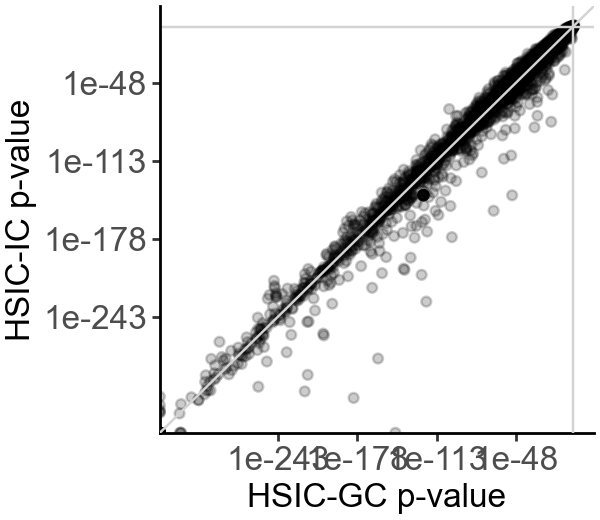

In [8]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-gc', y = 'pvalue_hsic-ic')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        # geom_point(aes(color = 'n_iso'), alpha = 0.5) + 
        # geom_text(
        #     _df.nsmallest(10, 'pvalue_spark-x').reset_index(),
        #     aes(label = 'gene_symbol')
        # ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-GC p-value', y = 'HSIC-IC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
              text = element_text(family='Arial', size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


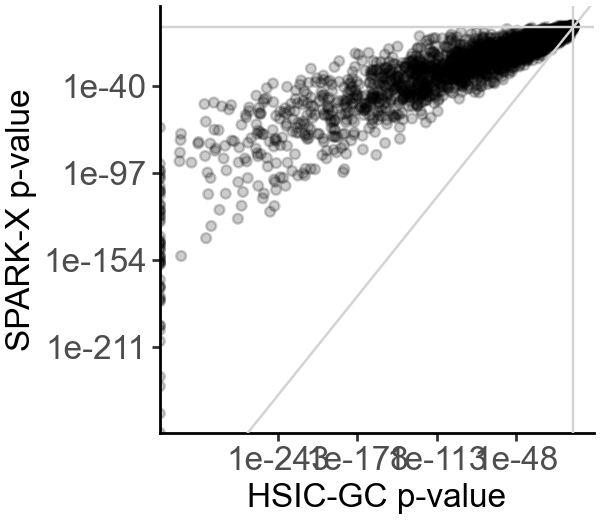

In [9]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-gc', y = 'pvalue_spark-x')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-GC p-value', y = 'SPARK-X p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
              text = element_text(family='Arial', size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


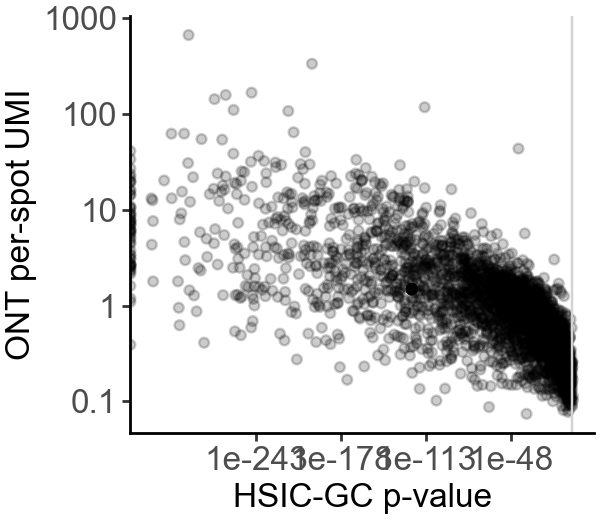

In [10]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-gc', y = 'count_avg')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        labs(x = 'HSIC-GC p-value', y = 'ONT per-spot UMI') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
              text = element_text(family='Arial', size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


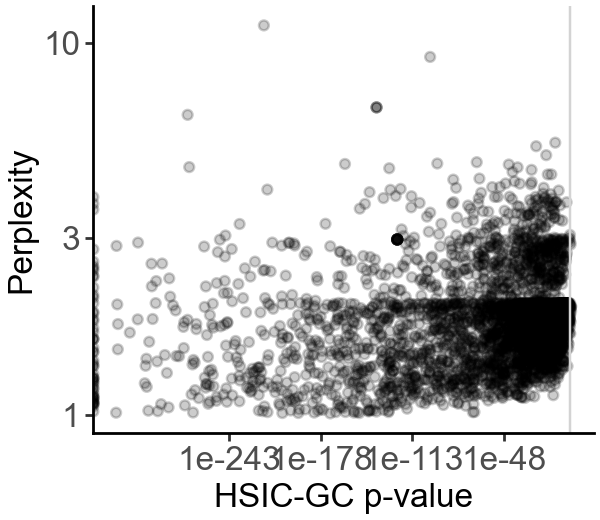

In [11]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'pvalue_hsic-gc', y = 'perplexity')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.2) + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        labs(x = 'HSIC-GC p-value', y = 'Perplexity') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
              text = element_text(family='Arial', size = 12))
)

#### With ONT CBS samples

In [12]:
res_dir_ont = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"
df_sv_cbs1 = pd.read_csv(f"{res_dir_ont}/sv_results/cbs1_sv_combined_1107.csv", index_col=0)
df_sv_cbs2 = pd.read_csv(f"{res_dir_ont}/sv_results/cbs2_sv_combined_1107.csv", index_col=0)

# define significant events
for _df in [df_sv_cbs1, df_sv_cbs2]:
    _df['is_ont_svs'] = _df['padj_hsic-ir'] < 0.05
    _df['is_ont_sve'] = _df['padj_hsic-gc'] < 0.05
    _df['is_ont_expressed'] = _df['count_avg'] > 0.5

# merge two cbs samples into one df
df_sv_ont = pd.merge(
    df_sv_cbs1, df_sv_cbs2, 
    how='inner', left_index=True, right_index=True, 
    suffixes=['_ont1', '_ont2']
)
df_sv_ont['is_ont_svs'] = df_sv_ont['is_ont_svs_ont1'] & df_sv_ont['is_ont_svs_ont2']
df_sv_ont['is_ont_sve'] = df_sv_ont['is_ont_sve_ont1'] & df_sv_ont['is_ont_sve_ont2']
df_sv_ont['is_ont_expressed'] = df_sv_ont['is_ont_expressed_ont1'] & df_sv_ont['is_ont_expressed_ont2']

df_sv_all = pd.merge(
    df_sv_cbs, df_sv_ont, 
    how='inner', left_index=True, right_index=True, 
    # suffixes=['_trend', '_ont']
)

In [13]:
df_sv_all.groupby(['is_trend_svs', 'is_ont_svs']).size()

is_trend_svs  is_ont_svs
False         False         617
              True           46
True          False         196
              True           33
dtype: int64

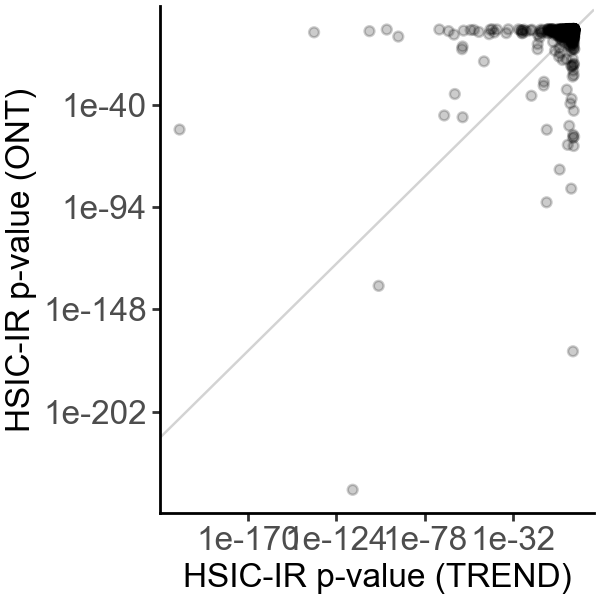

In [14]:
(
    ggplot(df_sv_all, aes(x = 'pvalue_hsic-ir', y = 'pvalue_hsic-ir_ont2')) + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'HSIC-IR p-value (TREND)', y = 'HSIC-IR p-value (ONT)') + 
        geom_point(alpha = 0.2) + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,3],
              text = element_text(family='Arial', size = 12))
)

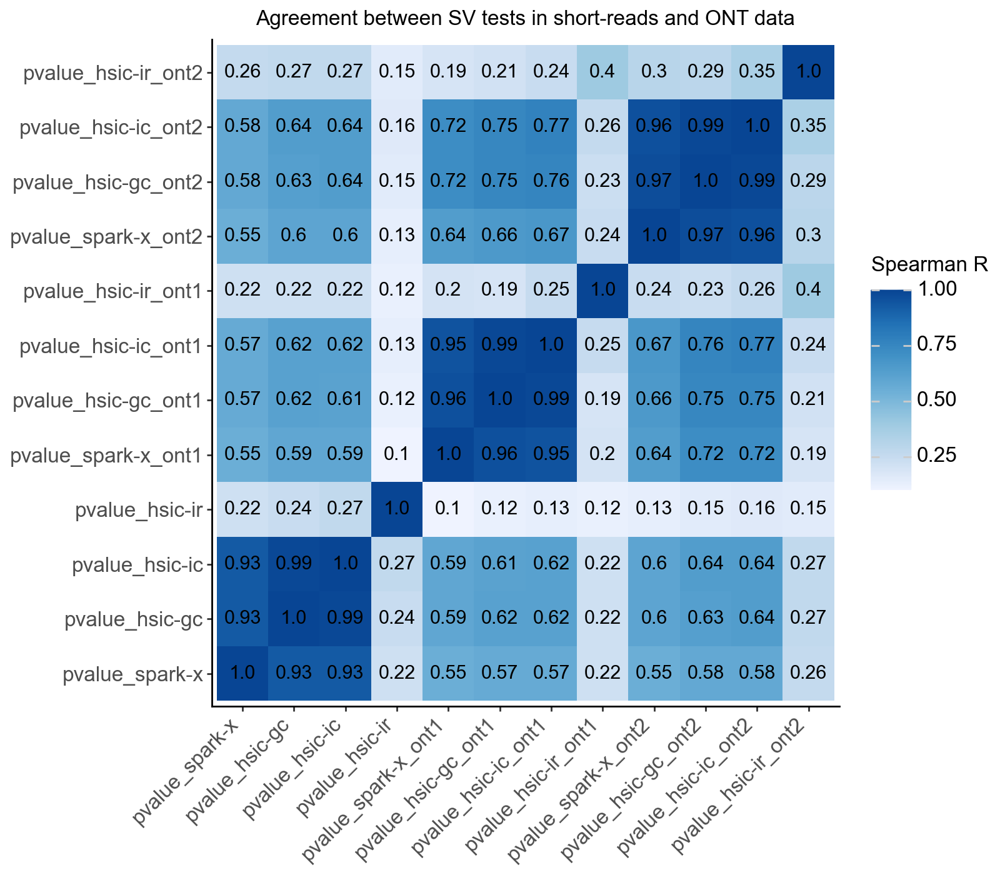

In [15]:
_cols_to_compare = [f"{_col}{_s}" 
    for _s in ['', '_ont1', '_ont2']
    for _col in ['pvalue_spark-x', 'pvalue_hsic-gc', 'pvalue_hsic-ic', 'pvalue_hsic-ir']
]

# calculate Spearmann correlation across tests and samples
# _df = df_sv_all.loc[df_sv_all['is_trend_expressed'], _cols_to_compare]
_df = df_sv_all.loc[:, _cols_to_compare]
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0] * (spearmanr(_df)[1] <= 0.01),
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

# remove non-significant results
_conf_mat.loc[_conf_mat['value'] == 0, 'value'] = np.nan

_conf_mat['id'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['variable'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between SV tests in short-reads and ONT data') + 
        theme_classic() + 
        theme(
            figure_size=[8, 7],
            text = element_text(family='Arial', size = 12), 
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

### Check SV gene expression

#### TREND data sparsity

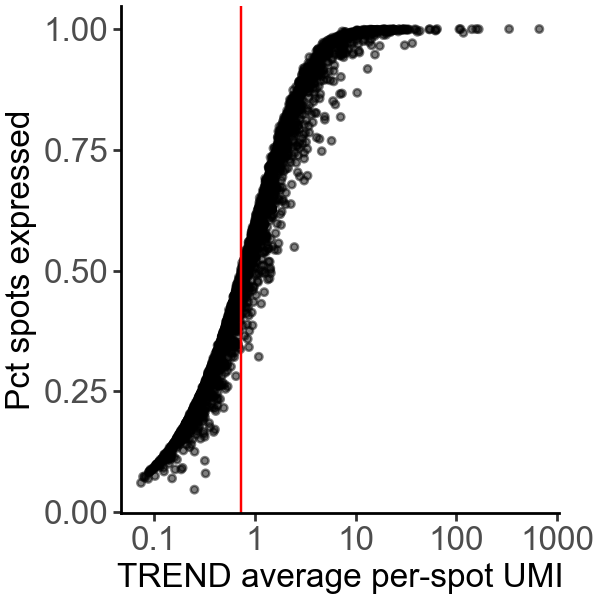

In [16]:
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(y = 'pct_spot_on', x = 'count_avg')) + 
        geom_point(alpha = 0.5, size = 1) + 
        geom_vline(xintercept = _df['count_avg'].median(), color = 'red') + 
        scale_x_log10() + 
        labs(x = 'TREND average per-spot UMI', y = 'Pct spots expressed') + 
        theme_classic() + 
        theme(
            figure_size=[3, 3],
            text = element_text(family='arial', size = 12),
        )
)

#### TREND expression of SV genes

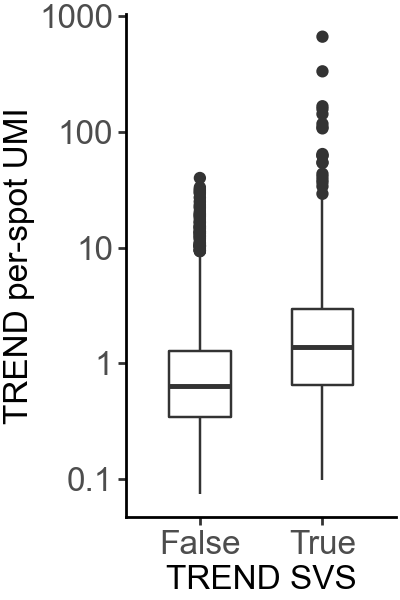

In [17]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_trend_svs', y = 'count_avg')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'TREND SVS', y = 'TREND per-spot UMI') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[2, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

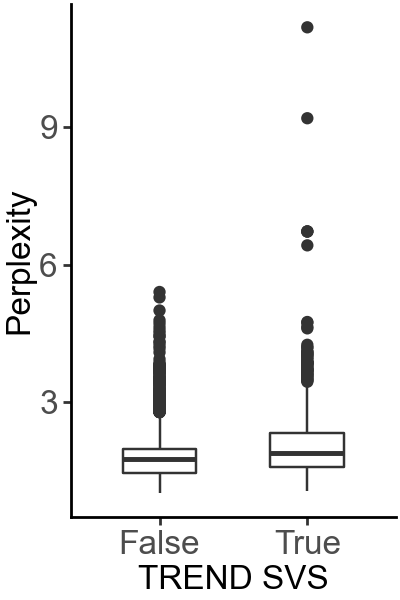

In [18]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_trend_svs', y = 'perplexity')) + 
        geom_boxplot(width = 0.5) + 
        # scale_y_log10() + 
        labs(x = 'TREND SVS', y = 'Perplexity') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[2, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

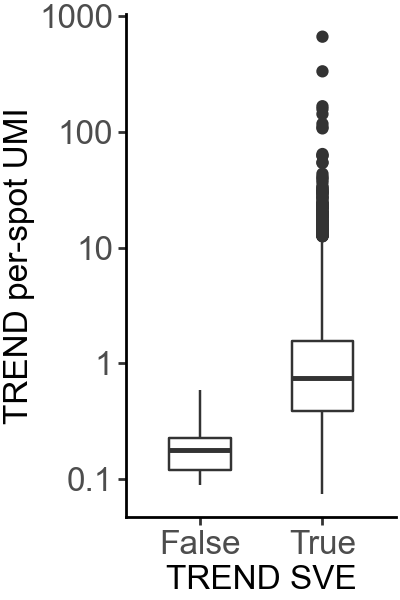

In [19]:
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_trend_sve', y = 'count_avg')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'TREND SVE', y = 'TREND per-spot UMI') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[2, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

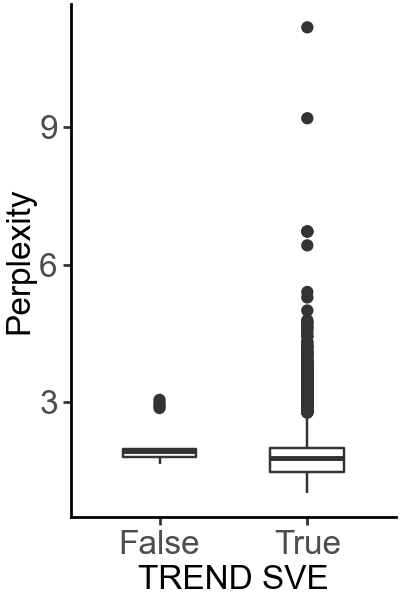

In [20]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].reset_index(names = 'gene_symbol')
_df = df_sv_cbs.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'is_trend_sve', y = 'perplexity')) + 
        geom_boxplot(width = 0.5) + 
        # scale_y_log10() + 
        labs(x = 'TREND SVE', y = 'Perplexity') + 
        # scale_fill_manual(values={True: _pal['svs'], False: _pal['not_svs']}) + 
        theme_classic() + 
        theme(
            figure_size=[2, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

#### Visium expression of SV genes

In [21]:
# load the count data
adata_visium = sc.read_10x_h5(f"{data_dir}/Visium_Fresh_Frozen_Adult_Mouse_Brain_filtered_feature_bc_matrix.h5") # short-read gene counts
adata_visium.raw = adata_visium.copy() # raw counts data
adata_visium.var['gene_symbols'] = adata_visium.var_names
adata_visium.var_names_make_unique()

# filter out barely expressed genes
sc.pp.filter_genes(adata_visium, min_cells=0.01 * adata_visium.shape[0])
adata_visium.layers['counts'] = adata_visium.X.copy()

# log normalize
sc.pp.normalize_total(adata_visium, target_sum=1e4)
sc.pp.log1p(adata_visium)
adata_visium.layers['log1p'] = adata_visium.X.copy()

# load the Visium spatial metadata 
adata_visium = load_visium_sp_meta(adata_visium, f"{data_dir}/visium_spatial_meta", library_id='adata_visium')

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [22]:
df_gene_visium = adata_visium.var.copy()
df_gene_visium['count_avg_visium'] = np.asarray(adata_visium.layers['counts'].mean(0)).squeeze()
df_gene_visium['trend_pass_qc'] = df_gene_visium.index.isin(df_sv_cbs.index)

# add TREND qc results
df_gene_visium = pd.merge(
    df_gene_visium, df_sv_cbs, 
    left_index=True, right_index=True, how = 'left'
)

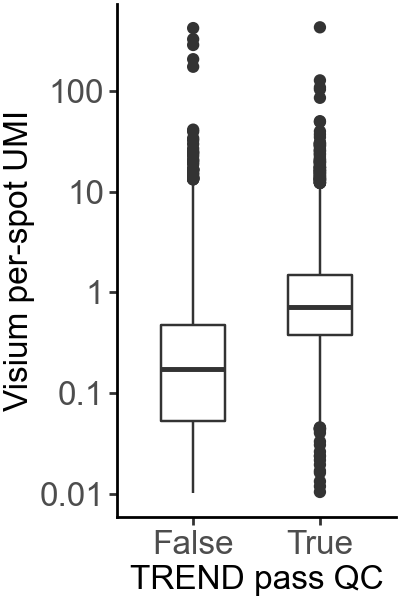

In [23]:
_df = df_gene_visium.reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'trend_pass_qc', y = 'count_avg_visium')) + 
        geom_boxplot(width = 0.5) + 
        scale_y_log10() + 
        labs(x = 'TREND pass QC', y = 'Visium per-spot UMI') + 
        theme_classic() + 
        theme(
            figure_size=[2, 3],
            text = element_text(family='arial', size = 12),
            legend_position='none'
        )
)

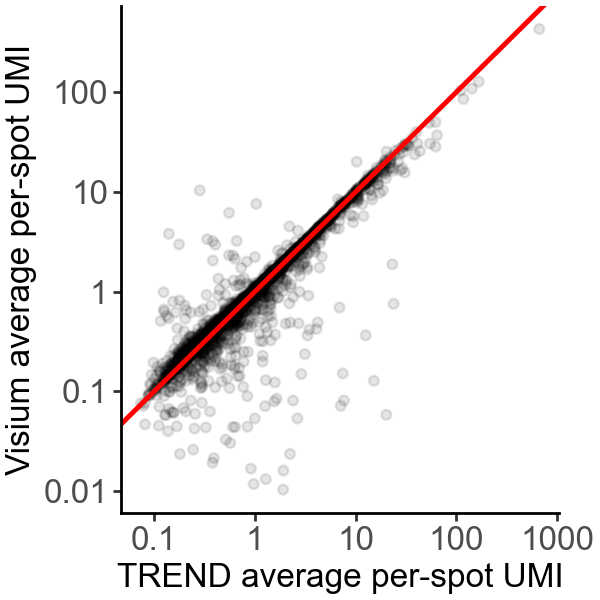

In [24]:
_df = df_gene_visium.loc[df_gene_visium['trend_pass_qc']].reset_index(names = 'gene_symbol')
(
    ggplot(_df, aes(x = 'count_avg', y = 'count_avg_visium')) + 
        geom_point(alpha = 0.1) + 
        # stat_density_2d(levels = 10) + 
        scale_y_log10() + 
        scale_x_log10() + 
        geom_abline(slope = 1, color = 'red', size = 1) + 
        # geom_abline(slope = 1, intercept = np.log10(0.2), color = 'red', size = 1) + 
        # geom_text(
        #     data = pd.DataFrame([{'x': 10, 'y': 30, 'label': 'y = 0.2*x'}]),
        #     mapping = aes(x = 'x', y = 'y', label = 'label'),
        #     color = 'red'
        # ) + 
        labs(y = 'Visium average per-spot UMI', x = 'TREND average per-spot UMI') + 
        theme_classic() + 
        theme(
            figure_size=[3, 3],
            text = element_text(family='arial', size = 12)
        )
)

### Functional enrichment analysis

In [25]:
def get_enrich_res(
    svs_gene_list,
    svens_gene_list,
    sources_list = ['GO:BP'],
    topk = 20,
    return_enr_res = False
):
    # run enrichment analysis
    enr_svs = sc.queries.enrich(
        svs_gene_list, org="mmusculus", 
        gprofiler_kwargs = {'all_results': True, 'sources': sources_list},
    )
    enr_svens = sc.queries.enrich(
        svens_gene_list, org="mmusculus", 
        gprofiler_kwargs = {'all_results': True, 'sources': sources_list},
    )

    # extract significant positive and negative functional terms
    _top_term_svs = enr_svs.loc[enr_svs['significant'], 'native'].to_list()
    _top_go_svens = enr_svens.loc[enr_svens['significant'], 'native'].to_list()
    
    # combine results
    df_term = pd.concat([
        enr_svs.loc[
            enr_svs['native'].isin(_top_term_svs + _top_go_svens),
            # ['source', 'native', 'name', 'description', 'term_size']
        ].assign(geneset = 'SVS'),
        enr_svens.loc[
            enr_svens['native'].isin(_top_term_svs + _top_go_svens),
            # ['source', 'native', 'name', 'description', 'term_size']
        ].assign(geneset = 'SVE'),
    ])
    
    # calculated precision differences
    unstacked = df_term.groupby(['native', 'geneset'])['precision'].mean().unstack()
    unstacked['precision_diff'] = unstacked['SVS'] - unstacked['SVE']
    df_term = df_term.merge(unstacked[['precision_diff']], on='native', how='left')
    
    # sort terms by the precision difference and keep top terms
    _order1 = df_term.sort_values('precision_diff', ascending=True).head(topk)['name'].unique().tolist()
    _order2 = df_term.sort_values('precision_diff', ascending=False).head(topk)['name'].unique().tolist()
    df_term = df_term.loc[df_term['name'].isin(_order1 + _order2)]

    # sort resulting dataframe by precision difference
    df_term.sort_values(by = 'precision_diff', inplace = True)
    df_term['name_cat'] = pd.Categorical(df_term['name'], ordered=True, categories=df_term['name'].unique())

    if not return_enr_res:
        return df_term
    else:
        return df_term, enr_svs, enr_svens

In [26]:
# _df = df_sv_cbs.loc[df_sv_cbs['is_trend_expressed']].copy()
_df = df_sv_cbs.copy()
_df.groupby(['is_trend_svs', 'is_trend_sve']).size()

# define the gene lists to compare
svs_gene_list = _df.index[_df['is_trend_svs']].to_list()
svens_gene_list = _df.index[(~ _df['is_trend_svs']) & (_df['is_trend_sve'])].to_list()

#### Gene Ontology Enrichment

In [27]:
df_go = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['GO:BP'], topk=20)
df_go['name_cat'] = pd.Categorical(
    df_go['name_cat'].str.capitalize(), 
    ordered = True, categories=df_go['name_cat'].str.capitalize().unique()
)

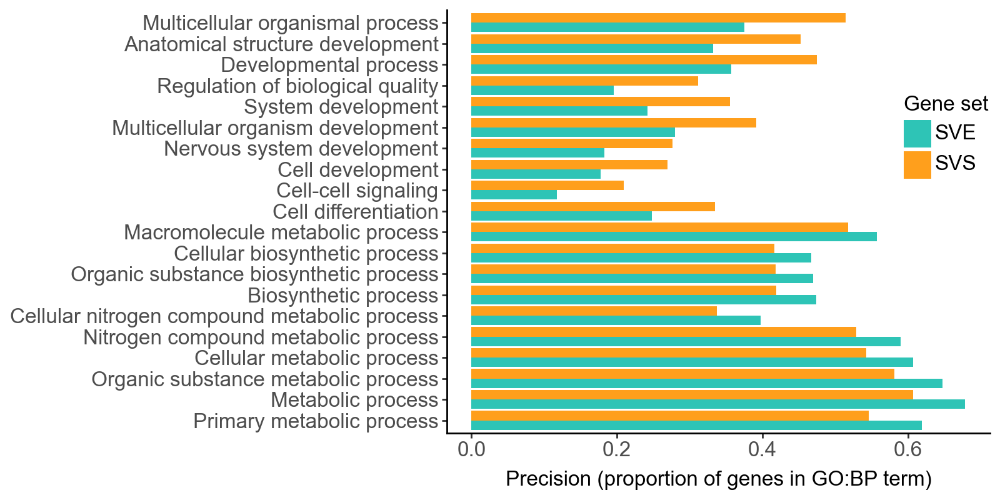

In [28]:
(
    ggplot(df_go, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in GO:BP term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(8,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

#### KEGG Enrichment

In [29]:
df_kegg = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['KEGG'], topk=20)

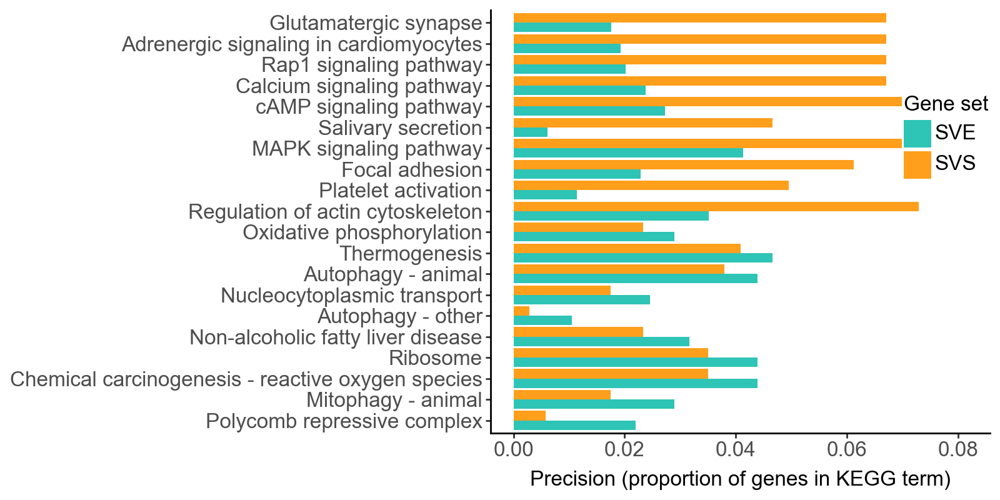

In [30]:
(
    ggplot(df_kegg, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in KEGG term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(8,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

#### Reactome Enrichment

In [31]:
df_reac = get_enrich_res(svs_gene_list, svens_gene_list, sources_list=['REAC'], topk=20)

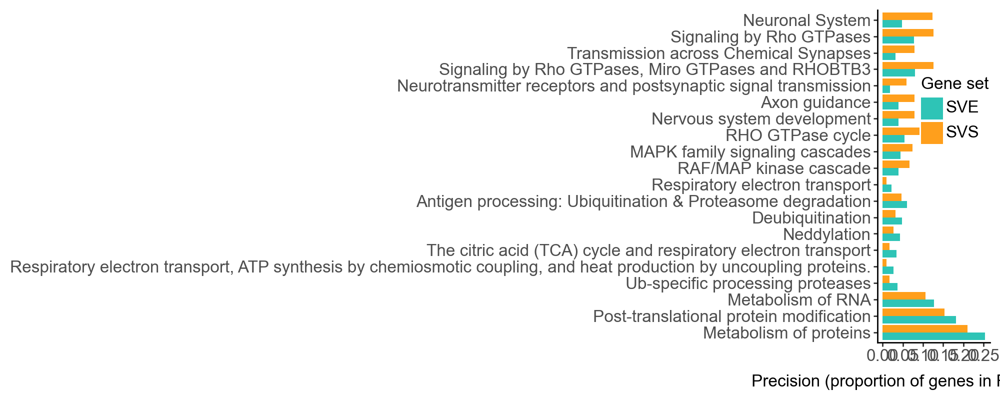

In [32]:
(
    ggplot(df_reac, aes(x = 'name_cat', y = 'precision', group = 'geneset', fill = 'geneset')) + 
        geom_bar(stat='identity', position='dodge') + 
        labs(y = 'Precision (proportion of genes in Reactome term)', x = '', fill = 'Gene set') + 
        coord_flip() + 
        scale_fill_manual(values={'SVS': '#FF9F1C', 'SVE': '#2EC4B6'}) + 
        theme_classic() + 
        theme(
            figure_size=(10,4),
            text=element_text(size = 12, family = 'Arial'),
            legend_position='inside',
            legend_position_inside = (1,0.75)
        )
)

## Prepare anndata with SV results

In [12]:
from smoother import SpatialWeightMatrix
from isosde.utils import extract_counts_n_ratios

# helper function to calculate smoothed counts and ratios
def calc_smoothed_counts_n_ratios(adata, p = 0.2):
    # compute spatial knn graph
    coords = adata.obs.loc[:, ['array_row', 'array_col']]
    swm = SpatialWeightMatrix()
    swm.calc_weights_knn(coords, k = 6)

    # compute locally smoothed isoform counts
    scaling = swm.swm.to_dense() * p + torch.eye(adata.shape[0]) * (1 - p) # (n_spots, n_spots)
    adata.layers['counts_smoothed'] = scaling.numpy() @ adata.layers['counts'] # (n_spots, n_total_isos)
    
    # calculate usage ratio from counts
    _, _, _, _ratio_merged = extract_counts_n_ratios(adata, layer = 'counts_smoothed', group_iso_by = 'gene_symbol')
    adata.layers['ratios_smoothed'] = _ratio_merged # (n_spots, n_total_isos)

    return adata

### Load and prepare anndata

#### Load peak anndata and compute smoothed ratios

In [13]:
# load the ONT count data
adata_peak = sc.read_h5ad(f"{res_dir}/anndata/cbs_peak_filtered_{date}.h5ad")

# compute smoothed counts and ratios
adata_peak = calc_smoothed_counts_n_ratios(adata_peak, p = 0.2)
adata_peak

Number of spots: 2797. Average number of neighbors per spot:  6.00.


AnnData object with n_obs × n_vars = 2797 × 8604
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_symbol', 'chr', 'position', 'strand', 'gene_id', 'n_cells', 'peak_id'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts', 'log1p', 'ratios_obs', 'counts_smoothed', 'ratios_smoothed'

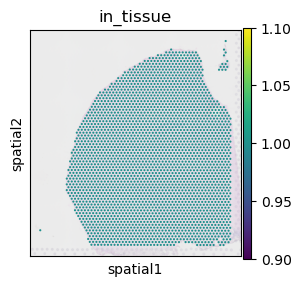

In [14]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak, color = ['in_tissue'], img_key = 'lowres', alpha_img=0.3)

In [15]:
# focus on expressed SVS genes only
_is_sig_svs = df_sv_cbs['is_trend_svs'] & df_sv_cbs['is_trend_expressed'] & \
        (~ df_sv_cbs.index.str.startswith('Gm')) & \
        (~ df_sv_cbs.index.str.endswith('Rik')) # exclude unannotated genes

_iso_ind = adata_peak.var['gene_symbol'].isin(
    df_sv_cbs.loc[_is_sig_svs].index
)
adata_peak_sv = adata_peak[:, _iso_ind].copy()

#### Load Visium RBP anndata

In [16]:
# load the visium rbp count data
adata_visium_rbp = sc.read_h5ad(f"{res_dir}/anndata/cbs_visium_rbp_{date}.h5ad")
# realign spots by index
adata_visium_rbp = adata_visium_rbp[adata_peak_sv.obs.index, :]

adata_visium_rbp.var.groupby(['is_rbp', 'is_visium_sve']).size()

is_rbp  is_visium_sve
True    False            439
        True             984
dtype: int64

#### Load GLMM fitting results

In [17]:
# load fitted GLMM model and extract inferred isoform ratio
glmm = torch.load(f"{res_dir}/model/cbs_peak_glmm_{date}.pkl")
glmm_model_list = glmm.get_fitted_models()

In [18]:
# extract estimated ratio
iso_ind_list = []

for i, (_gene, _group) in enumerate(adata_peak_sv.var.reset_index().groupby('gene_symbol')):
    assert glmm.gene_names[i] == _gene
    # extract isoform index per gene
    iso_ind_list.append(_group.index.tolist())

ratio_fitted_list = [_m.get_isoform_ratio().squeeze() for _m in glmm_model_list]

# reshape and store the fitted ratio in anndata
ratio_fitted_merged = torch.concat(ratio_fitted_list, axis = 1).numpy()
ratio_fitted_merged = ratio_fitted_merged[:, np.argsort(np.concatenate(iso_ind_list))]

adata_peak_sv.layers['ratios_glmm'] = ratio_fitted_merged.copy()

/var/folders/_f/m4v2g8c54gdfks59bp2f2cm80000gn/T/ipykernel_38172/692741701.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


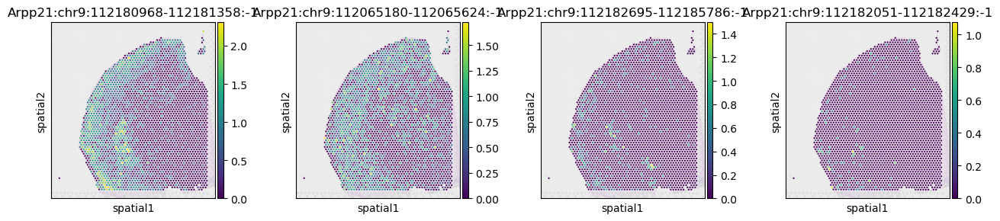

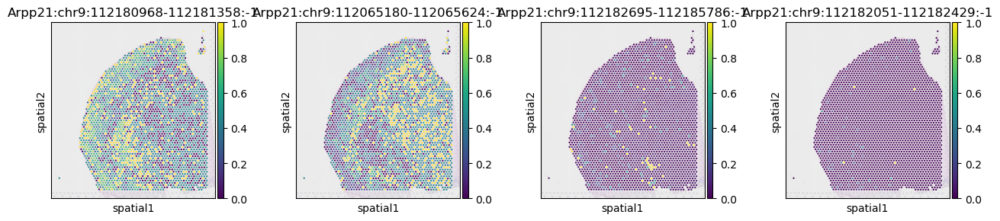

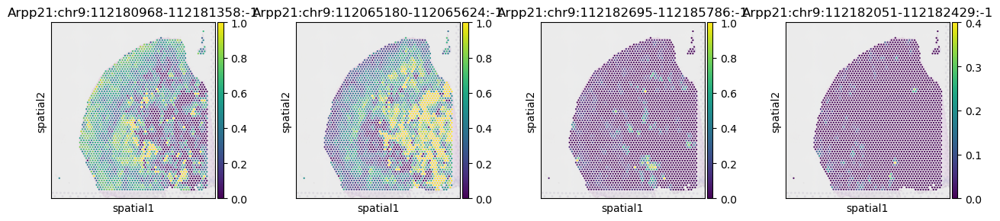

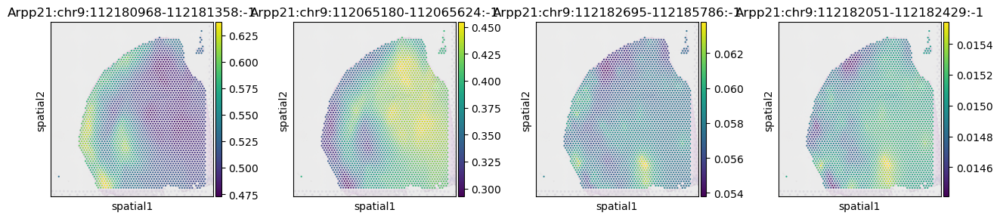

In [19]:
_iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == 'Arpp21']
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'log1p', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_obs', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_smoothed', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_glmm', ncols = len(_iso_to_plot))

### Clustering spots

#### Cluster by gene expression (top SVE)

In [20]:
# focus on expressed SVE genes only
_iso_ind = adata_peak.var['gene_symbol'].isin(
    # df_sv_cbs.loc[df_sv_cbs['is_trend_sve'] & df_sv_cbs['is_trend_expressed']].index
     df_sv_cbs.loc[df_sv_cbs['is_trend_sve']].sort_values('pvalue_hsic-gc').head(200).index
)
_data = adata_peak[:, _iso_ind].copy()

# calculate the total counts per gene
_mapping_matrix = pd.get_dummies(_data.var['gene_symbol'])
_isog_counts = _data[:, _mapping_matrix.index].layers['counts'] @ _mapping_matrix
# _isog_counts = _data[:, _mapping_matrix.index].layers['counts_smoothed'] @ _mapping_matrix

# create anndata obj
_data = sc.AnnData(
    _isog_counts,
    obs = adata_peak.obs
)

# log normalization
sc.pp.normalize_total(_data, target_sum=1e4)
sc.pp.log1p(_data)
_data.layers['log1p'] = _data.X.copy()

# pca and clustering
sc.tl.pca(_data, layer = 'log1p')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=0.5, flavor='igraph', n_iterations=2, key_added='trend_sve')

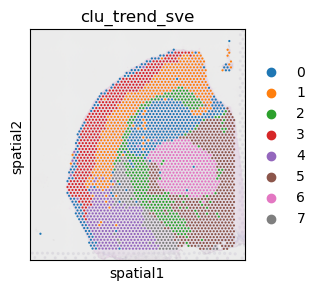

In [21]:
# store clustering results to the reference adata
adata_peak_sv.obs['clu_trend_sve'] = _data.obs['trend_sve']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak_sv, color = ['clu_trend_sve'], img_key = 'lowres', alpha_img=0.3)

#### Cluster by observed isoform ratio (top SVS)

In [22]:
# focus on expressed SVS genes only
# _data = adata_peak_sv.copy()
# focus on expressed SVE genes only
_iso_ind = adata_peak.var['gene_symbol'].isin(
     df_sv_cbs.loc[df_sv_cbs['is_trend_svs']].head(200).index
)
_data = adata_peak[:, _iso_ind].copy()
_data = calc_smoothed_counts_n_ratios(_data, p = 0.2)

# pca and clustering
# sc.tl.pca(_data, layer = 'ratios_smoothed')
sc.tl.pca(_data, layer = 'ratios_obs')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=1, flavor='igraph', n_iterations=2, key_added='trend_svs')

Number of spots: 2797. Average number of neighbors per spot:  6.00.


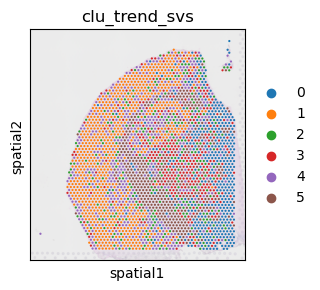

In [23]:
# store clustering results to the reference adata
adata_peak_sv.obs['clu_trend_svs'] = _data.obs['trend_svs']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak_sv, color = ['clu_trend_svs'], img_key = 'lowres', alpha_img=0.3)

#### Cluster by RBP visium expression

In [24]:
# focus on expressed SVE genes only
_data = adata_visium_rbp[adata_peak_sv.obs.index, adata_visium_rbp.var['is_visium_sve']].copy()
print(_data.shape)

# create anndata obj
_data = sc.AnnData(
    _data.layers['counts'],
    obs = adata_peak_sv.obs
)

# log normalization
sc.pp.normalize_total(_data, target_sum=1e4)
sc.pp.log1p(_data)
_data.layers['log1p'] = _data.X.copy()

# pca and clustering
sc.tl.pca(_data, layer = 'log1p')
sc.pp.neighbors(_data)
sc.tl.leiden(_data, resolution=0.8, flavor='igraph', n_iterations=2, key_added='visium_rbp_sve')

(2797, 984)


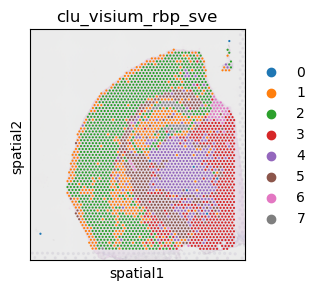

In [25]:
# store clustering results to the reference adata
adata_peak_sv.obs['clu_visium_rbp_sve'] = _data.obs['visium_rbp_sve']

with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak_sv, color = ['clu_visium_rbp_sve'], img_key = 'lowres', alpha_img=0.3)

#### Combinded visualization

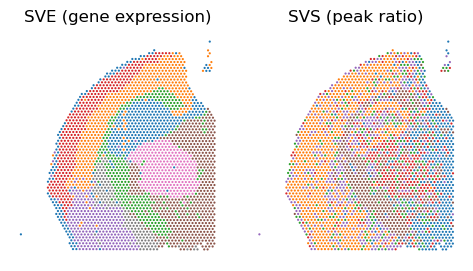

In [26]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(
        adata_peak_sv, color = ['clu_trend_sve', 'clu_trend_svs'], 
        title = ['SVE (gene expression)', 'SVS (peak ratio)'],
        legend_loc = 'none',
        img_key = 'lowres', alpha_img=0.0, wspace = 0,
        show = False, frameon = False,
    )
    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

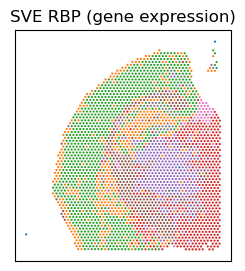

In [27]:
with plt.rc_context({"figure.figsize": (3, 3)}):
    axes = sc.pl.spatial(
        adata_peak_sv, color = ['clu_visium_rbp_sve'], 
        title = ['SVE RBP (gene expression)'],
        legend_loc = 'none',
        img_key = 'lowres', alpha_img=0.0, wspace = 0,
        show = False, frameon = True,
    )
    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')
        
    plt.show()

### Clustering genes

In [28]:
from scipy.stats import pearsonr

def RVcoeff(dataList):
    """
    This function computes the RV matrix correlation coefficients between pairs
    of arrays. The number and order of objects (rows) for the two arrays must
    match. The number of variables in each array may vary.

    PARAMETERS
    ----------
    dataList : list
        A list holding numpy arrays for which the RV coefficient will be computed.

    RETURNS
    -------
    numpy array
        A numpy array holding RV coefficients for pairs of numpy arrays. The
        diagonal in the result array holds ones, since RV is computed on
        identical arrays, i.e. first array in ``dataList`` against frist array
        in
    """

    # Centering columns for each data x
    dataList = [data.numpy() if isinstance(data, torch.Tensor) else data for data in dataList]
    dataList = [data - np.mean(data, axis=0, keepdims = True) for data in dataList]
    
    # Compute the scalar sqrt(tr(xTx)) for each data x
    scalArrList = [np.linalg.norm(x.T @ x, ord = 'fro') for x in dataList]

    # Compute the pairwise RV coefficient
    C = np.eye(len(dataList))

    # Fill the upper triangle
    for i in range(len(dataList)):
        for j in range(i, len(dataList)):
            xTy = dataList[i].T @ dataList[j]
            C[i, j] = (np.linalg.norm(xTy, ord = 'fro') ** 2) / (scalArrList[i] * scalArrList[j])

    # Make it squareform
    for i in range(len(dataList)):
        for j in range(i):
            C[i, j] = C[j, i]

    return C

# x = np.random.rand(100, 2)
# y = np.random.rand(100, 3)
# z = np.random.rand(100, 4)

# RVcoeff([x, y, z])

#### Compute and visualize RV coefficients

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn.manifold import MDS
from sklearn.cluster import SpectralClustering

In [30]:
counts_list, ratios_list, gene_name_list, _ = extract_counts_n_ratios(
    adata_peak_sv, layer = 'counts', group_iso_by = 'gene_symbol'
)
counts_smoothed_list, ratios_smoothed_list, _, _ = extract_counts_n_ratios(
    adata_peak_sv, layer = 'counts_smoothed', group_iso_by = 'gene_symbol'
)

rvcoef_ratio = RVcoeff(ratios_list)
rvcoef_ratio_smoothed = RVcoeff(ratios_smoothed_list)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


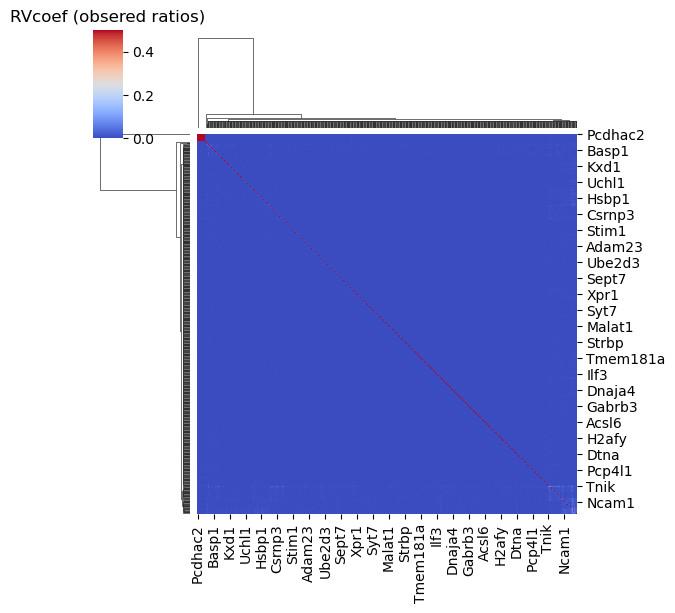

In [31]:
df_cor = pd.DataFrame(rvcoef_ratio, index=gene_name_list, columns=gene_name_list)

# Create a heatmap for the correlation matrix
sns.clustermap(
    df_cor,
    method="ward",  # Hierarchical clustering method
    metric="euclidean",  # Distance metric
    cmap="coolwarm",  # Color map
    annot=False,  # Annotate with correlation values
    vmin=0, vmax=0.5,
    figsize=(6, 6)
)

# Add title and axis labels
plt.title("RVcoef (obsered ratios)", fontsize=12)
plt.show()

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.


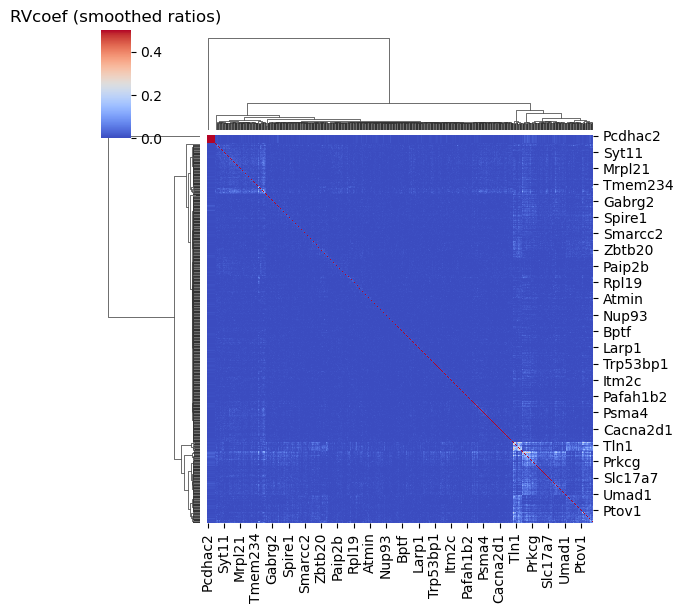

In [32]:
df_cor = pd.DataFrame(rvcoef_ratio_smoothed, index=gene_name_list, columns=gene_name_list)

# Create a heatmap for the correlation matrix
sns.clustermap(
    df_cor,
    method="ward",  # Hierarchical clustering method
    metric="euclidean",  # Distance metric
    cmap="coolwarm",  # Color map
    annot=False,  # Annotate with correlation values
    vmin=0, vmax=0.5,
    figsize=(6, 6)
)

# Add title and axis labels
plt.title("RVcoef (smoothed ratios)", fontsize=12)
plt.show()

#### MDS distance embedding

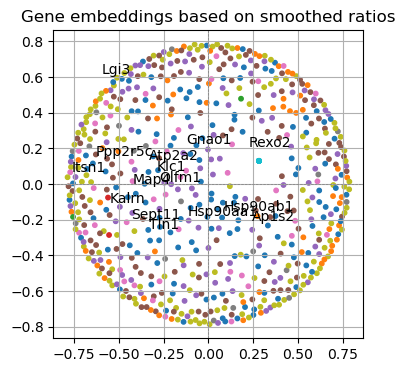

In [35]:
# Use the RV coefficient as affinity
correlation_matrix = rvcoef_ratio_smoothed

# Step 1: Convert correlation matrix into a similarity matrix
# Spectral Clustering directly works with similarity matrices (like correlation matrices), 
# so no need to convert it to a distance matrix.

# Step 2: Perform Spectral Clustering
num_clusters = 10  # Define the number of clusters
spectral = SpectralClustering(
    n_clusters=num_clusters,
    affinity='precomputed',  # Use the correlation matrix directly
    random_state=42
)
cluster_labels = spectral.fit_predict(correlation_matrix)

# Step 3: Perform MDS for 2D embedding (visualization purposes)
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
distance_matrix = 1 - correlation_matrix  # Convert to distance matrix for MDS
embedded_coords = mds.fit_transform(distance_matrix)

# Step 4: Visualize the clustering results
# Assign colors to clusters
colors = plt.cm.tab10(cluster_labels)

# Extract x and y coordinates
x_coords = embedded_coords[:, 0]
y_coords = embedded_coords[:, 1]

# Visualize the results
plt.figure(figsize=(4, 4))
scatter = plt.scatter(
    x_coords, y_coords, c=colors, 
    # cmap='tab10', 
    s=10, 
)

# Annotate points for clarity
for i, (x, y) in enumerate(zip(x_coords, y_coords)):
    if gene_name_list[i] in ['Itsn1', 'Map4', 'Atp2a2', 'Klc1', 'Cdc42'
                             'Sept8', 'Sept11', 'Hsp90aa1', 'Hsp90ab1', 'Olfm1', 
                             'Kalrn', 'Rexo2', 'Ppp2r5c', 'Ap1s2', 'Lgi3',
                             'Gnao1', 'Tln1', 'Klc1'
                            ]:
        plt.text(x, y, f'{gene_name_list[i]}', fontsize=10, ha='right')

plt.title('Gene embeddings based on smoothed ratios')
plt.xlabel('')
plt.ylabel('')
plt.axhline(0, color='gray', linestyle='--', linewidth=0.5)
plt.axvline(0, color='gray', linestyle='--', linewidth=0.5)
plt.grid(True)
plt.show()

#### Visualize archetypes

In [36]:
for clu in range(10):
    _n = [g for g, c in zip(gene_name_list, cluster_labels) if c == clu]
    _n = df_sv_cbs.loc[df_sv_cbs.index.isin(_n)].head(5).index.to_list()
    print(f"Clu {clu}: {_n}")

Clu 0: ['Gpm6a', 'Atp1b1', 'Zdhhc8', 'Celf2', 'Ntrk2']
Clu 1: ['Hsp90aa1', 'Map1b', 'Atp1a2', 'Ttll3', 'Gria2']
Clu 2: ['Hdhd2', 'Ier3ip1']
Clu 3: ['Prn', 'Prnp']
Clu 4: ['Sept8', 'Mbp', 'Map4', 'Myl6', 'Sptbn1']
Clu 5: ['Arpp21', 'Rps8', 'Rtn1', 'Sv2a', 'Camk2n1']
Clu 6: ['Ttr', 'Gnao1', 'Cdc42', 'Camta1', 'Klc1']
Clu 7: ['mt-Co1', 'Actb', 'Gabbr1', 'mt-Nd2', 'Pakap']
Clu 8: ['Serf2', 'mt-Rnr2', 'Sv2c', 'Dnaja3', 'Ptprd']
Clu 9: ['Pcdha9', 'Pcdha1', 'Pcdha8', 'Pcdhac2', 'Pcdha12']


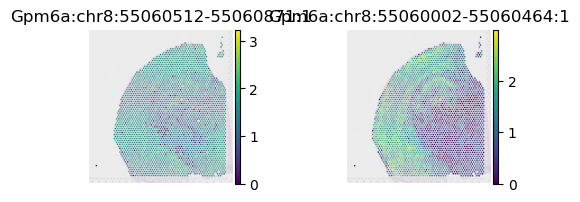

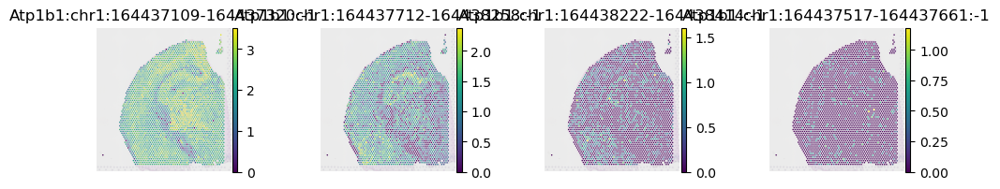

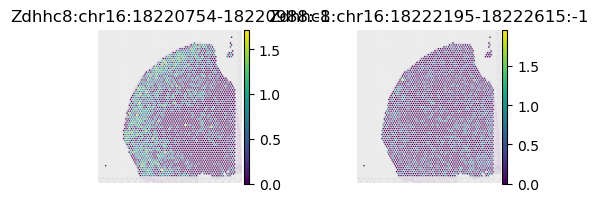

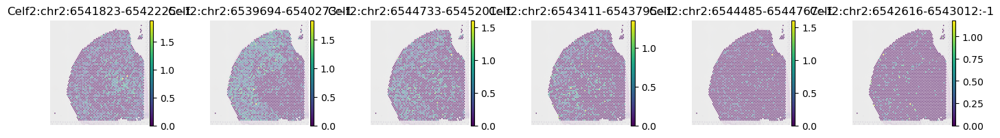

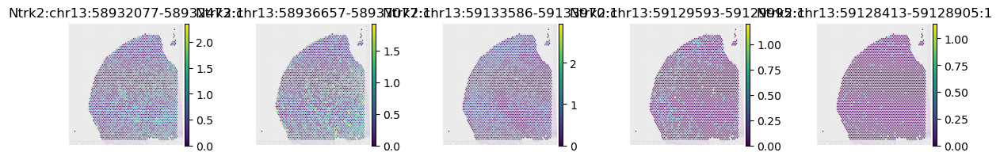

In [37]:
_svs_to_plot = ['Gpm6a', 'Atp1b1', 'Zdhhc8', 'Celf2', 'Ntrk2']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

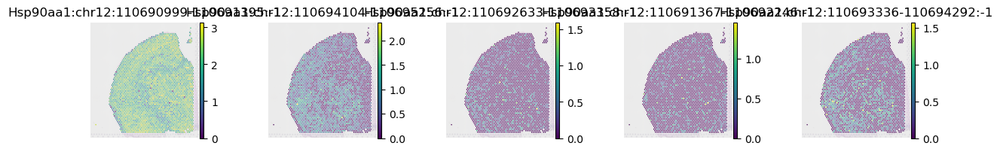

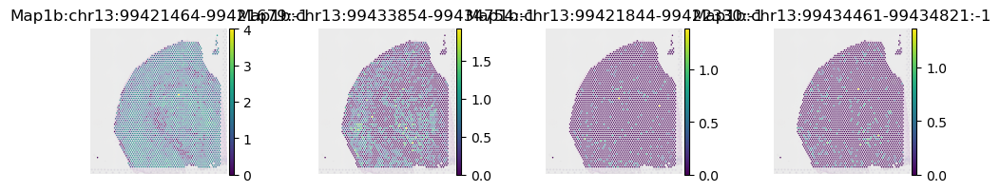

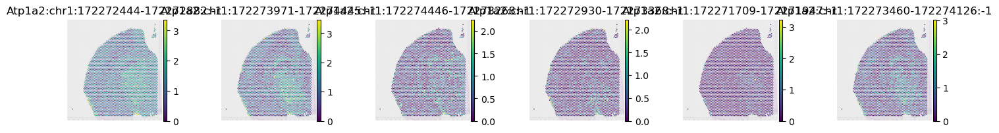

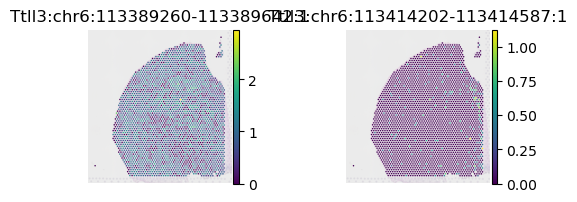

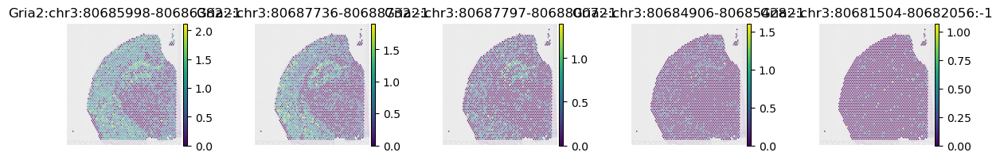

In [38]:
_svs_to_plot = ['Hsp90aa1', 'Map1b', 'Atp1a2', 'Ttll3', 'Gria2']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot,
            img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

### Anndata I/O

#### Save the ONT SVS anndata with cluster and GLMM results

In [39]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"
date = '1119'

adata_peak_sv.write_h5ad(f"{res_dir}/anndata/cbs_svs_clu_{date}.h5ad")

#### Load precomputed ONT SVS anndata with cluster and GLMM results

In [40]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"
date = '1119'

adata_peak_sv = sc.read_h5ad(f"{res_dir}/anndata/cbs_svs_clu_{date}.h5ad")

### Visualize isoform usage of selected genes

#### Neuronal vs glial APA usage
Itsn1, Map4, Atp2a2, Rnf130, Klc1, Ptpn2, and Cdc42
* Rnf130 not pass QC
* Ptpn2 low expression
* All others are SVS


cTag-PAPERCLIP Reveals Alternative Polyadenylation Promotes Cell-Type Specific Protein Diversity and Shifts Araf Isoforms with Microglia Activation. https://www.cell.com/neuron/fulltext/S0896-6273(17)30739-0#gr3

In [181]:
# Rnf130 not pass QC
_svs_to_plot = ['Itsn1', 'Map4', 'Atp2a2', 'Klc1', 'Ptpn2', 'Cdc42']
df_sv_cbs.loc[_svs_to_plot]

,n_iso,pct_spot_on,count_avg,count_std,perplexity,major_ratio_avg,pvalue_hsic-ir,padj_hsic-ir,pvalue_hsic-ic,padj_hsic-ic,pvalue_hsic-gc,padj_hsic-gc,pvalue_spark-x,padj_spark-x,is_trend_svs,is_trend_sve,is_trend_expressed
gene,,,,,,,,,,,,,,,,,
Itsn1,4,0.495888,0.740436,0.927774,3.448116,0.400290,5.898431e-09,6.583170e-08,3.055784e-43,6.868719e-43,5.636397e-31,9.965804e-31,4.166240e-10,6.060001e-09,True,True,True
Map4,6,0.939936,3.921702,2.956111,3.705397,0.458383,5.380347e-105,1.269044e-102,2.568442e-155,2.254876e-154,5.056100e-67,1.591502e-66,1.010592e-19,2.680433e-18,True,True,True
Atp2a2,3,0.982481,8.065427,5.544729,1.795596,0.791081,4.207913e-76,6.472868e-74,7.330057e-210,1.189621e-208,3.541776e-186,4.540146e-185,1.818549e-36,1.021583e-34,True,True,True
Klc1,2,0.979621,7.209153,4.970943,1.222577,0.949167,4.647762e-45,2.884874e-43,2.121273e-213,3.556902e-212,7.576746e-203,1.196720e-201,1.312256e-37,7.678262e-36,True,True,True
Ptpn2,2,0.169825,0.191991,0.452183,1.872162,0.679702,1.567012e-03,7.153661e-03,3.396752e-09,3.979374e-09,4.173327e-10,4.864986e-10,2.082581e-05,2.242927e-04,True,True,False
Cdc42,5,0.964962,6.933858,4.847653,3.113037,0.467413,6.016828e-63,6.082154e-61,3.160735e-128,1.986266e-127,3.870451e-102,1.830702e-101,1.694425e-24,5.645555e-23,True,True,True


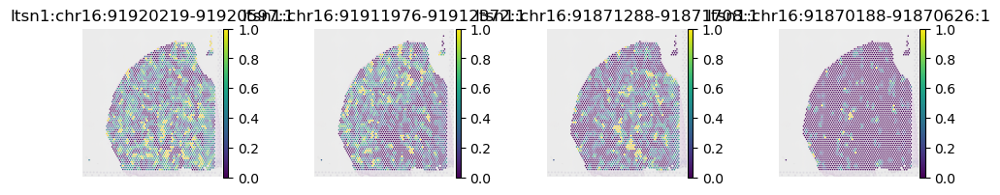

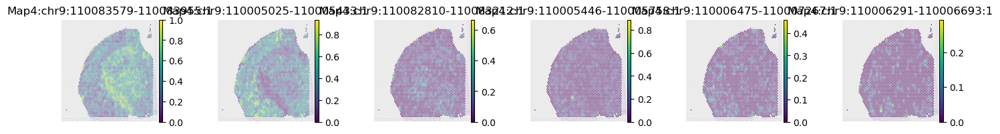

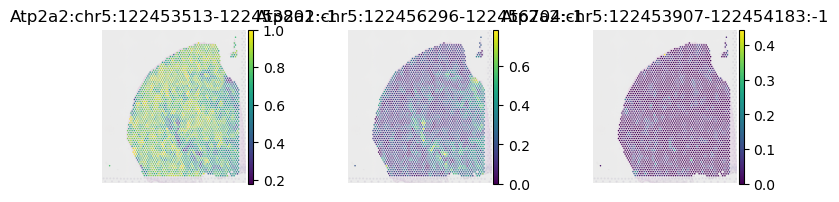

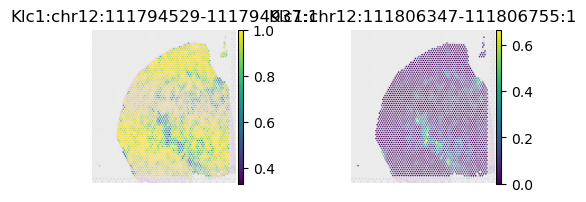

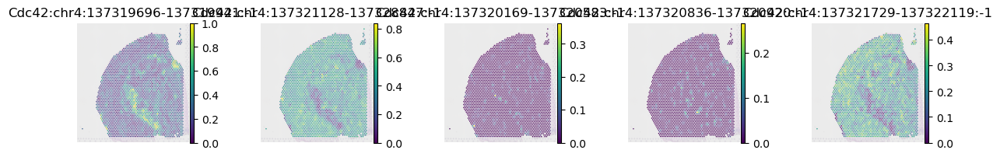

In [184]:
_svs_to_plot = ['Itsn1', 'Map4', 'Atp2a2', 'Klc1', 'Cdc42']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

#### SVS with CDS changes

In [254]:
# note that some CDS changes co-occurs with UTR3 and are not annotated
peak_annot = pd.read_table(f"{data_dir}/peak_no_cutoff.annot.txt").reset_index(names = 'peak_id')
svs_in_cds_list = peak_annot.loc[peak_annot['CDS'] == 'YES', 'gene_id'].unique()

_df = df_sv_cbs.loc[
    df_sv_cbs.index.isin(svs_in_cds_list) & \
    df_sv_cbs['is_trend_svs'] & \
    df_sv_cbs['is_trend_expressed']
]
_df.head(30)

,n_iso,pct_spot_on,count_avg,count_std,perplexity,major_ratio_avg,pvalue_hsic-ir,padj_hsic-ir,pvalue_hsic-ic,padj_hsic-ic,pvalue_hsic-gc,padj_hsic-gc,pvalue_spark-x,padj_spark-x,is_trend_svs,is_trend_sve,is_trend_expressed
gene,,,,,,,,,,,,,,,,,
mt-Co1,4,1.000000,665.187000,220.841900,2.292402,0.653735,2.194680e-214,2.588260e-211,1.233159e-290,5.386317e-289,1.499638e-295,7.169889e-294,3.539120e-69,6.443866e-67,True,True,True
Ttr,3,0.992134,117.456920,1307.739700,1.943591,0.715570,5.086581e-160,2.999387e-157,1.682844e-114,8.993811e-114,1.129855e-114,6.056709e-114,4.185390e-09,5.689485e-08,True,True,True
Hsp90aa1,5,0.997140,17.164820,9.500072,1.799332,0.851073,1.267892e-117,3.738168e-115,2.305197e-189,2.987468e-188,1.070747e-167,1.141055e-166,1.063230e-52,1.158801e-50,True,True,True
Camk2n1,6,0.996067,21.902039,22.963177,2.585633,0.734084,1.549047e-62,1.522369e-60,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.169125e-237,1.206256e-233,True,True,True
Actb,3,0.997497,16.340364,7.456799,1.823533,0.742845,1.840526e-60,1.669687e-58,5.298117e-104,2.539938e-103,3.986439e-94,1.724208e-93,3.042011e-13,5.483913e-12,True,True,True
Olfm1,4,0.978548,14.205935,14.633862,2.481179,0.544496,3.482435e-59,3.080214e-57,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.303204e-139,2.840096e-136,True,True,True
Map1b,4,0.963532,7.146585,4.814838,1.606585,0.870079,8.487752e-44,5.004945e-42,5.355739e-132,3.528604e-131,3.899874e-124,2.326772e-123,1.755007e-20,4.803042e-19,True,True,True
H3f3b,4,0.926707,4.440114,3.543651,2.762916,0.556728,4.103803e-36,1.910428e-34,4.264992e-140,3.011885e-139,1.827972e-116,1.002693e-115,2.636368e-28,1.025163e-26,True,True,True
mt-Nd2,2,0.999642,142.498750,49.453690,1.775984,0.738755,1.957841e-35,8.658552e-34,2.996528e-274,1.060172e-272,1.149269e-275,4.517905e-274,1.112906e-90,3.704038e-88,True,True,True


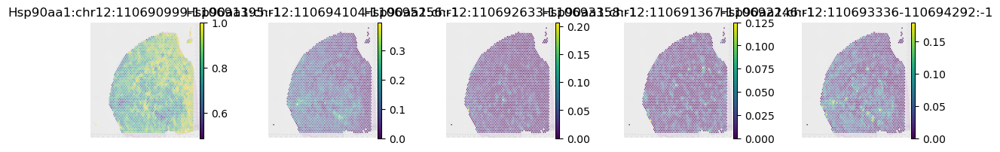

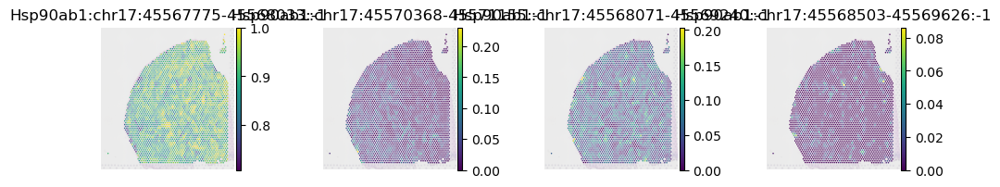

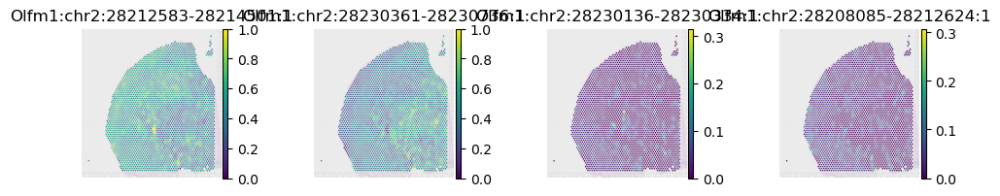

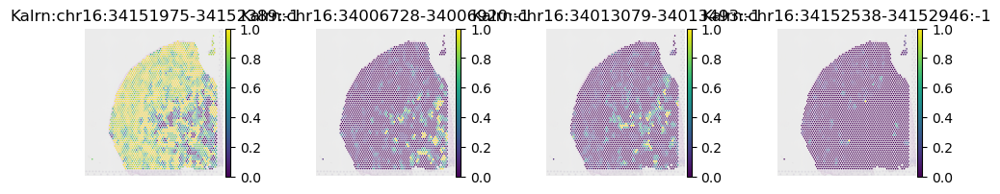

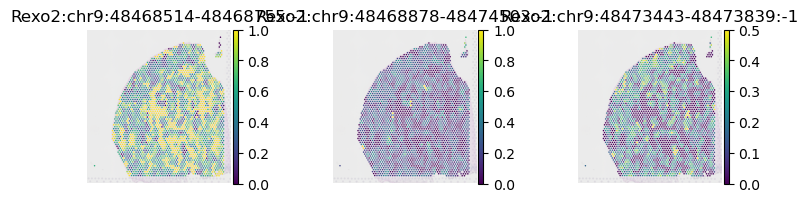

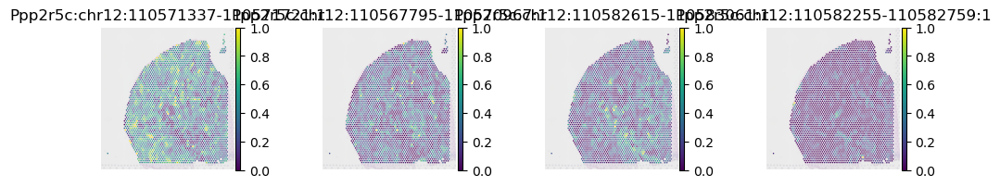

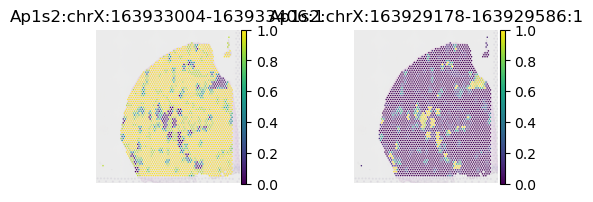

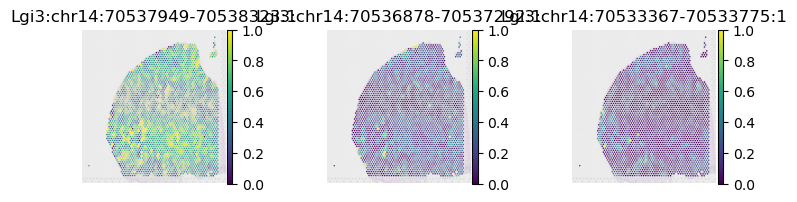

In [255]:
_svs_to_plot = ['Hsp90aa1', 'Hsp90ab1', 'Olfm1', 'Kalrn', 'Rexo2', 'Ppp2r5c', 'Ap1s2', 'Lgi3']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

#### G protein genes

In [59]:
_svs_to_plot = adata_peak_sv.var['gene_symbol'][
    adata_peak_sv.var['gene_symbol'].str.startswith('Gna')
].unique()
df_sv_cbs.loc[_svs_to_plot].sort_values('pvalue_hsic-ir', ascending = True)

,n_iso,pct_spot_on,count_avg,count_std,perplexity,major_ratio_avg,pvalue_hsic-ir,padj_hsic-ir,pvalue_hsic-ic,padj_hsic-ic,pvalue_hsic-gc,padj_hsic-gc,pvalue_spark-x,padj_spark-x,is_trend_svs,is_trend_sve,is_trend_expressed
gene,,,,,,,,,,,,,,,,,
Gnao1,5,0.972471,8.927780,6.386027,2.907925,0.567578,5.171333e-71,7.036991e-69,3.296409e-217,5.831348e-216,1.358494e-201,2.089718e-200,3.265010e-48,2.920845e-46,True,True,True
Gnai2,3,0.874866,2.730783,2.263819,1.947963,0.785677,1.307456e-28,4.720184e-27,1.942258e-127,1.207682e-126,5.732026e-112,2.977960e-111,4.578830e-34,2.334887e-32,True,True,True
Gnas,3,0.998570,23.982481,13.984210,1.237883,0.954546,4.793947e-23,1.390245e-21,5.345677e-236,1.212372e-234,4.446040e-236,1.014844e-234,8.387487e-80,2.181649e-77,True,True,True
Gnal,4,0.619235,1.111548,1.210016,2.558629,0.695722,7.853990e-13,1.368838e-11,2.953424e-74,1.015473e-73,3.294396e-56,8.931473e-56,8.261170e-13,1.450405e-11,True,True,True
Gnaq,3,0.590990,1.060422,1.242034,2.520549,0.546190,3.283822e-06,2.549788e-05,9.372239e-67,2.929239e-66,7.826345e-67,2.452578e-66,3.005431e-22,8.988070e-21,True,True,True


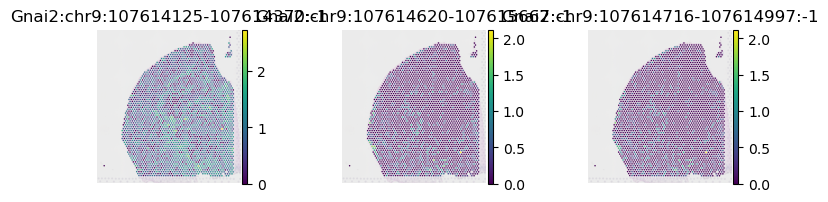

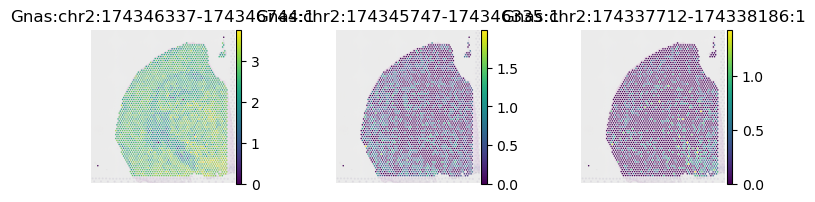

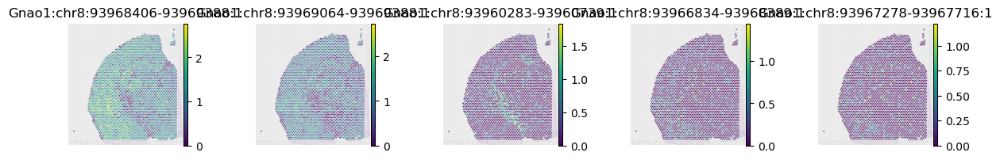

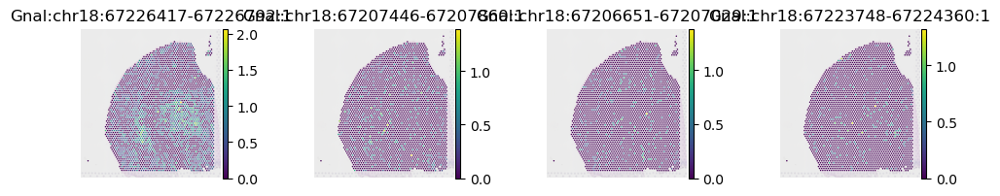

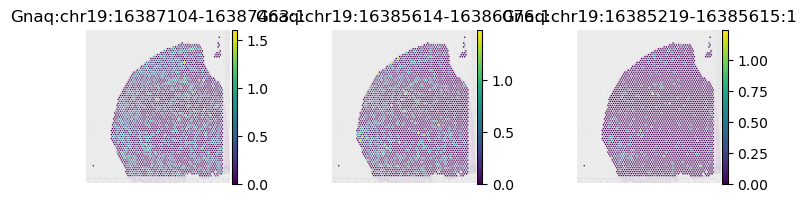

In [60]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

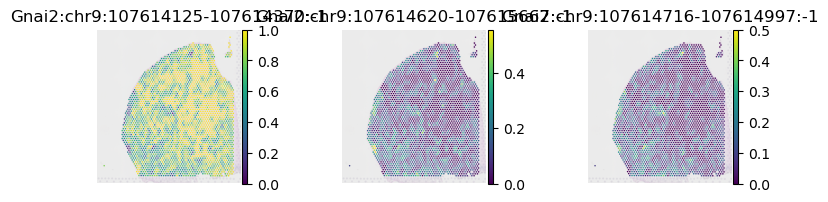

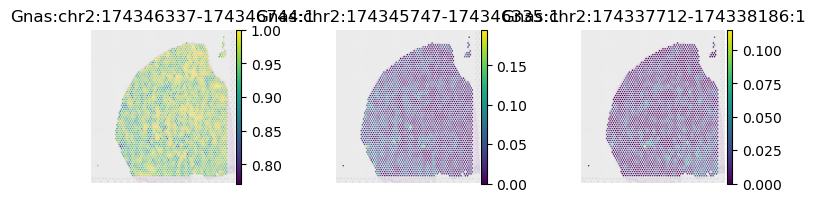

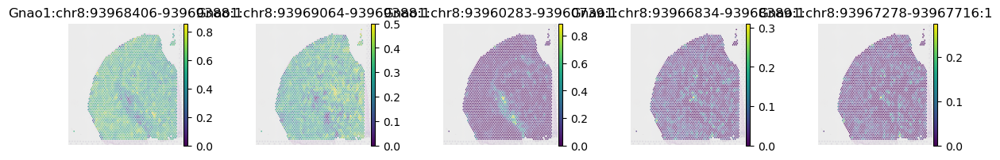

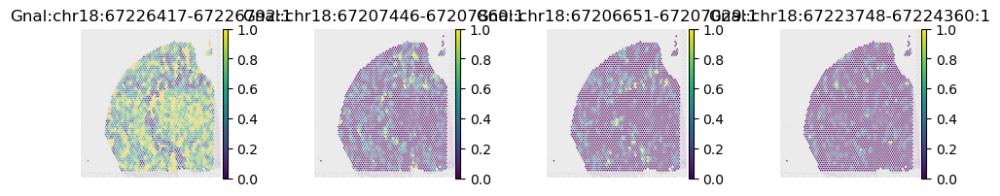

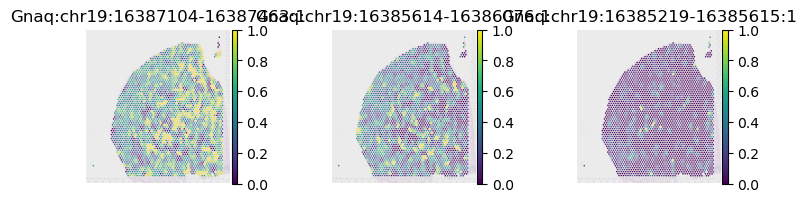

In [53]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

#### GPCR genes

In [65]:
# load list of GPCR genes
gpcr = pd.read_csv(f'{res_dir}/GPCR_human2mouse.csv', index_col=0)
_svs_to_plot = gpcr['ortholog_name'][
    gpcr['ortholog_name'].isin(adata_peak_sv.var['gene_symbol'].unique())
].to_list() + ['Adgrl1']
df_sv_cbs.loc[_svs_to_plot].sort_values('pvalue_hsic-ir', ascending = True)

,n_iso,pct_spot_on,count_avg,count_std,perplexity,major_ratio_avg,pvalue_hsic-ir,padj_hsic-ir,pvalue_hsic-ic,padj_hsic-ic,pvalue_hsic-gc,padj_hsic-gc,pvalue_spark-x,padj_spark-x,is_trend_svs,is_trend_sve,is_trend_expressed
gene,,,,,,,,,,,,,,,,,
Gabbr1,6,0.973543,7.100107,4.673309,3.620908,0.495090,1.732035e-44,1.056541e-42,1.830214e-155,1.610770e-154,1.314054e-114,7.022846e-114,3.830269e-14,7.242370e-13,True,True,True
Grm5,4,0.598498,1.234895,1.485320,2.061034,0.796178,1.987740e-14,3.995809e-13,6.742425e-82,2.532346e-81,6.478558e-97,2.894083e-96,2.665301e-28,1.035114e-26,True,True,True
Adgrl1,2,0.875581,3.171613,2.596003,1.642340,0.803066,2.559390e-04,1.444198e-03,9.330977e-204,1.392953e-202,1.075400e-218,1.992024e-217,1.458636e-67,2.536454e-65,True,True,True


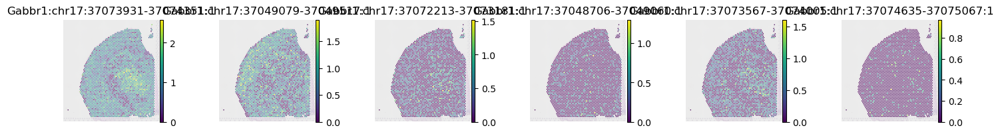

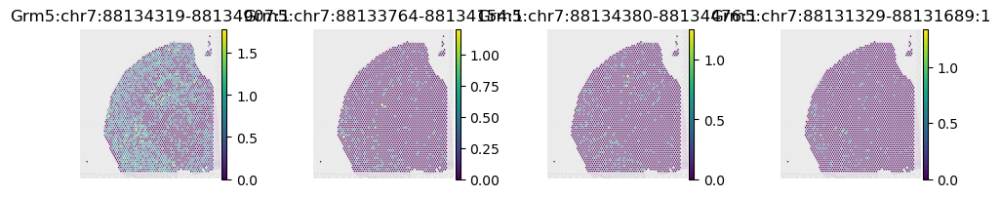

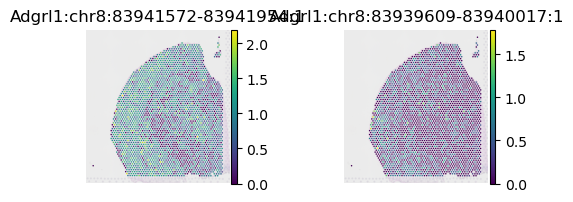

In [66]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key g= 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

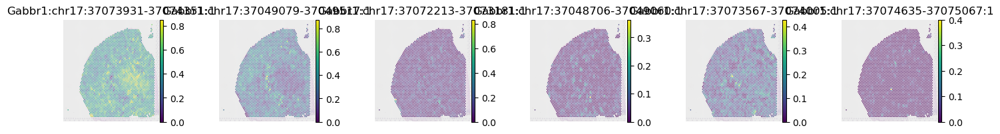

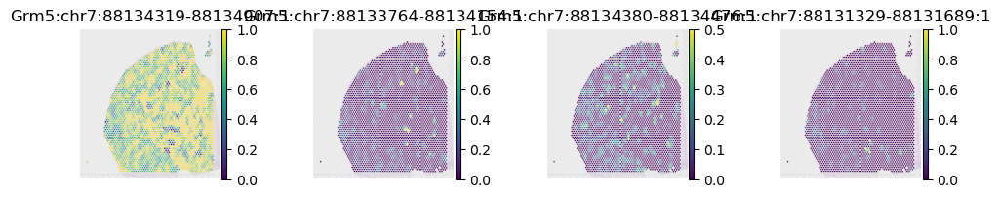

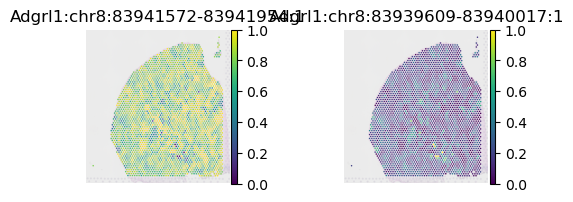

In [67]:
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

#### Visualize novel SVS genes

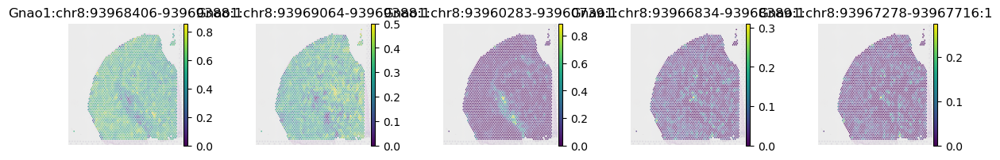

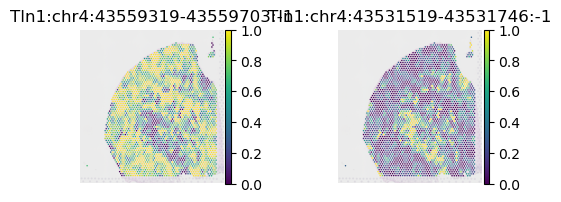

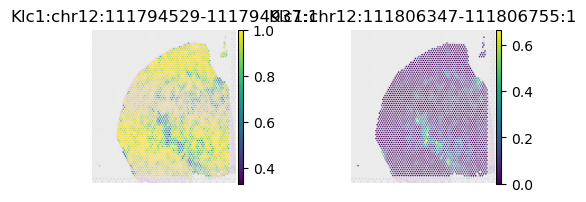

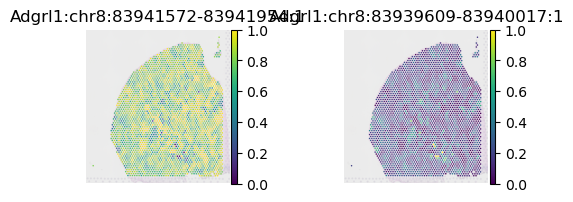

In [26]:
_svs_to_plot = ["Gnao1","Tln1", "Klc1", "Adgrl1"]
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

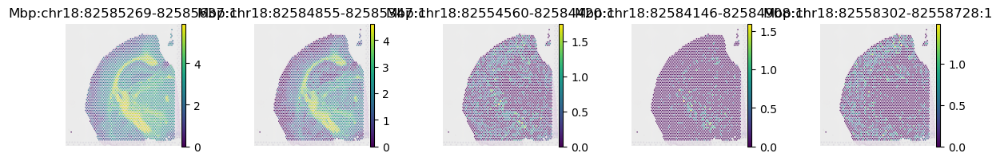

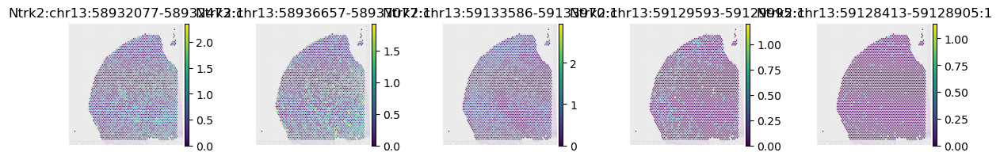

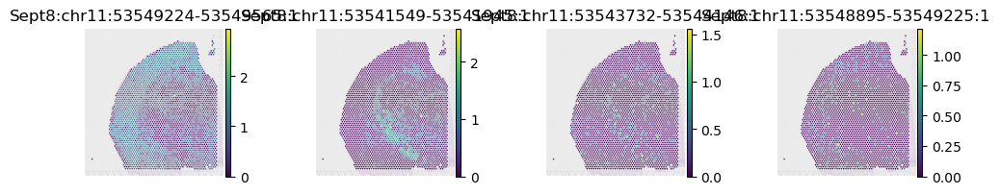

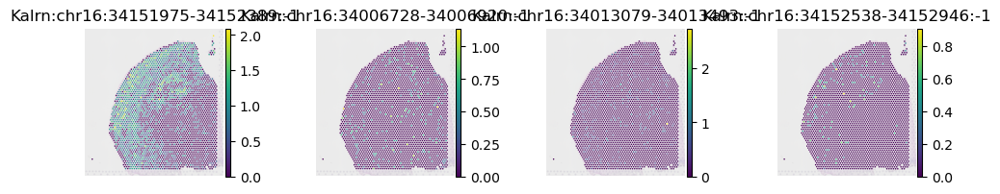

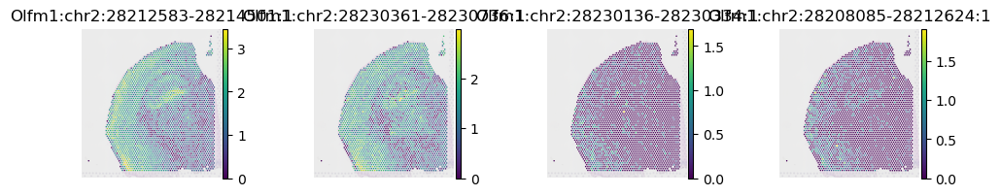

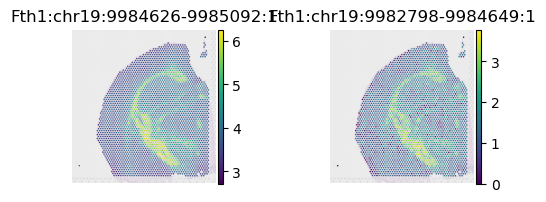

In [15]:
_svs_to_plot = ['Mbp', 'Ntrk2', 'Sept8', 'Kalrn', 'Olfm1', 'Fth1']
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'log1p', ncols = len(_iso_to_plot),
            frameon=False
        )

## Differential usage (DU) tests with RBP expression

### Load DU test results

In [8]:
# merge parametric and non-parametric test results
def load_du_tests(sample_id):
    df_du_hsic = pd.read_csv(f"{res_dir}/du_results/{sample_id}_rbp_du_np_combined_{date}.csv", index_col=[0,1])
    df_du_glmm = pd.read_csv(f"{res_dir}/du_results/{sample_id}_rbp_du_p_combined_{date}.csv", index_col=[0,1])
    df_du_rbp = df_du_hsic.join(df_du_glmm).reset_index()
    return df_du_rbp

df_du_cbs = load_du_tests('cbs')

### Compare DU test p-values

#### Within the short-reads sample

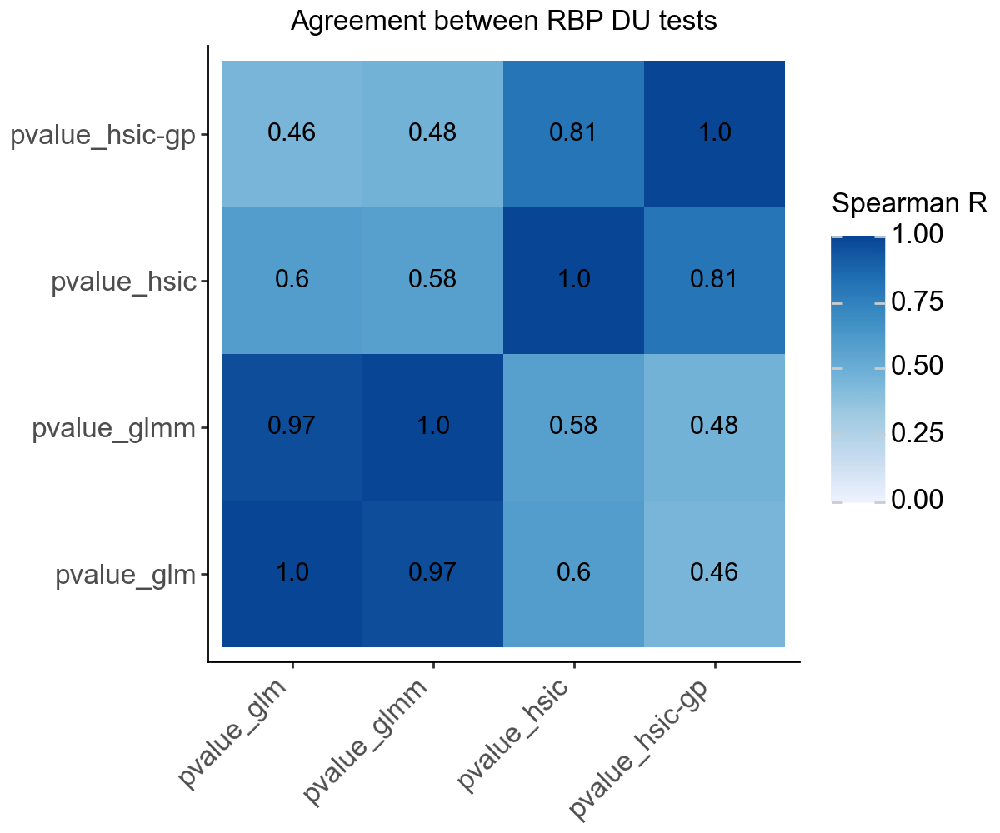

In [63]:
_df = df_du_cbs.set_index(['gene', 'covariate'])

_conf_mat = pd.DataFrame(
    spearmanr(_df)[0], 
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

# _order = [f'pvalue_{s}_{i}' for i, s in itertools.product(['1', '2'], ['hsic_ratio', 'glm', 'glmm'])]
# _conf_mat['x'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_order)
# _conf_mat['y'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_order)

(
    ggplot(_conf_mat, aes(x = 'id', y = 'variable', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (0, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between RBP DU tests') + 
        theme_classic() + 
        theme(
            figure_size=[6, 5],
            text = element_text(family='arial', size = 12), 
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


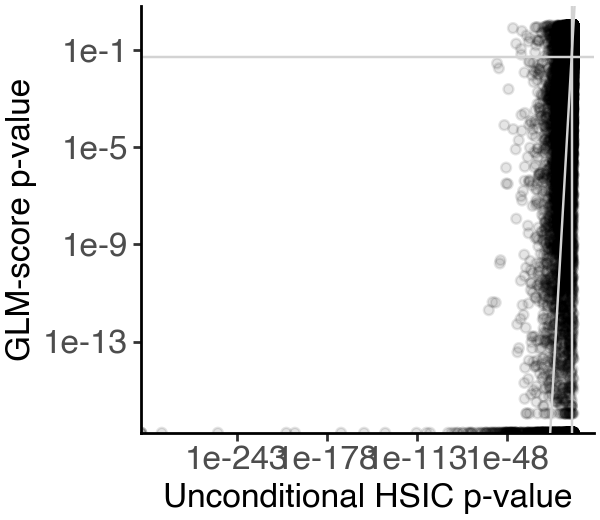

In [64]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_hsic', y = 'pvalue_glm')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'Unconditional HSIC p-value', y = 'GLM-score p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/plotnine/layer.py:364: PlotnineWarning: geom_point : Removed 4 rows containing missing values.


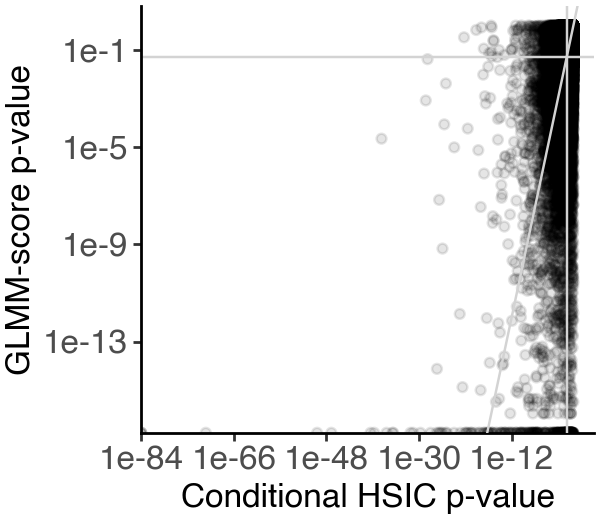

In [65]:
_df = df_du_cbs
(
    ggplot(_df, aes(y = 'pvalue_glmm', x = 'pvalue_hsic-gp')) +
        # stat_density_2d(levels = 10) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10(limits = [1e-80, 1]) + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


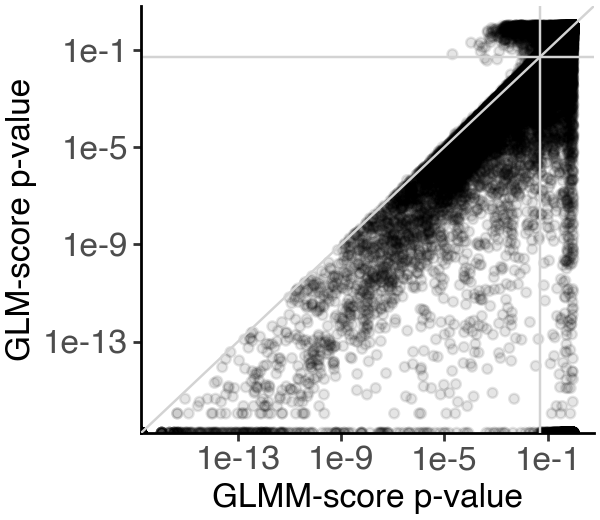

In [66]:
_df = df_du_cbs
(
    ggplot(_df, aes(x = 'pvalue_glmm', y = 'pvalue_glm')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(x = 'GLMM-score p-value', y = 'GLM-score p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


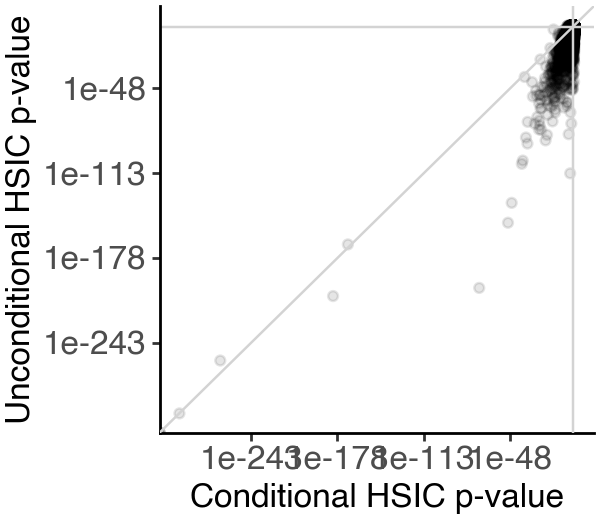

In [67]:
_df = df_du_cbs
(
    ggplot(_df, aes(y = 'pvalue_hsic', x = 'pvalue_hsic-gp')) +
        # stat_density_2d(levels = 5) + 
        geom_point(alpha = 0.1) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'Unconditional HSIC p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

#### With ONT CBS samples

In [68]:
# merge parametric and non-parametric test results
def load_du_tests(sample_id):
    res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/sit_nar_23/"
    date = '1107'
    df_du_hsic = pd.read_csv(f"{res_dir}/du_np_results/{sample_id}_rbp_du_np_combined_{date}.csv", index_col=[0,1])
    df_du_glmm = pd.read_csv(f"{res_dir}/du_p_results/{sample_id}_rbp_du_p_combined_{date}.csv", index_col=[0,1])
    df_du_rbp = df_du_hsic.join(df_du_glmm)
    return df_du_rbp

# load DU results for the two replicates
df_du_ont1 = load_du_tests('cbs1')
df_du_ont2 = load_du_tests('cbs2')

# define significant events
for _df in [df_du_ont1, df_du_ont2]:
    _df['is_significant'] = (_df['pvalue_hsic-gp'] < 0.01) & (_df['pvalue_glmm'] < 0.01)

# merge two cbs samples into one df
# all of the remaining target genes are SVS in both samples
df_du_ont = pd.merge(
    df_du_ont1, df_du_ont2, 
    how='inner', left_index=True, right_index=True, 
    suffixes=['_ont1', '_ont2']
).reset_index()

# keep significant genes in both samples
df_du_ont['is_significant'] = df_du_ont['is_significant_ont1'] & df_du_ont['is_significant_ont2']

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/plotnine/layer.py:364: PlotnineWarning: geom_text : Removed 2 rows containing missing values.


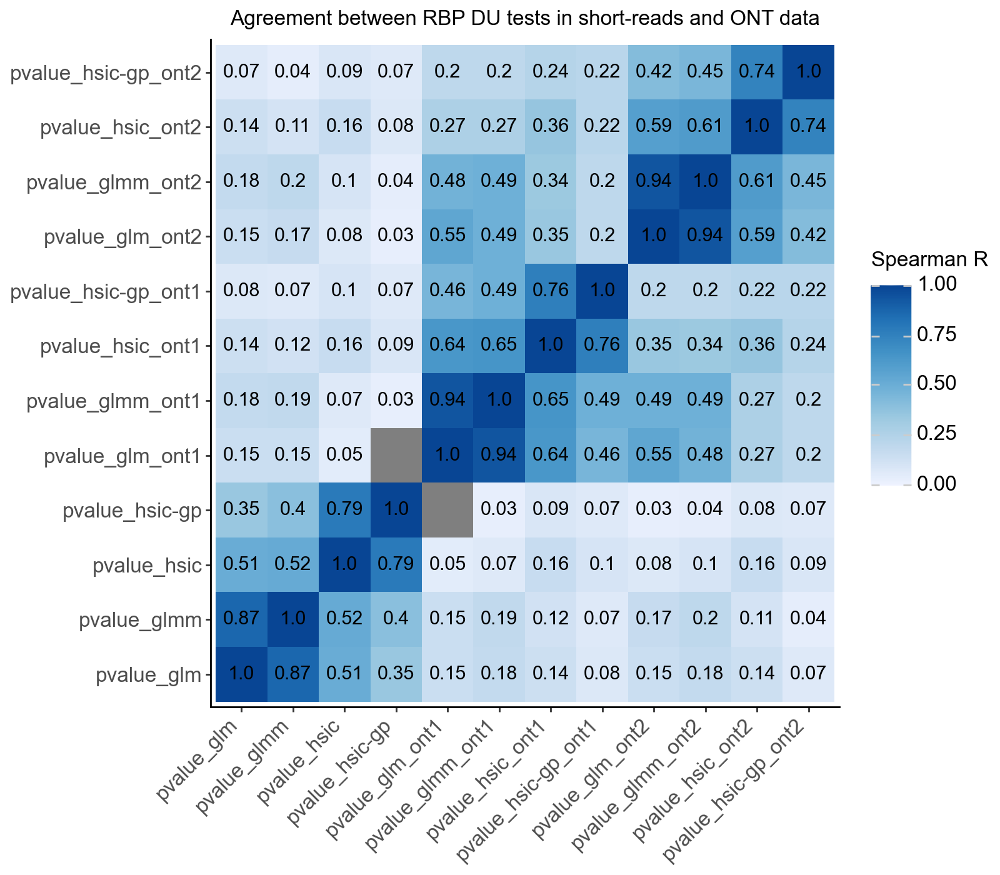

In [69]:
_df = pd.merge(df_du_cbs, df_du_ont)
_df = _df.set_index(['gene', 'covariate'])

# select test stats to compare
_cols_to_compare = [f"{_col}{_s}" 
    for _s in ['', '_ont1', '_ont2']
    for _col in ['pvalue_glm', 'pvalue_glmm', 'pvalue_hsic', 'pvalue_hsic-gp']
]
# _df = _df.loc[_df['is_significant'], _cols_to_compare]
_df = _df.loc[:, _cols_to_compare]

# compute Spearman correlation for selected columns
_conf_mat = pd.DataFrame(
    spearmanr(_df)[0] * (spearmanr(_df)[1] <= 0.01),
    columns = _df.columns, 
    index = _df.columns
).reset_index(names='id')
_conf_mat = pd.melt(_conf_mat, id_vars='id').round(2)

# remove non-significant results
_conf_mat.loc[_conf_mat['value'] == 0, 'value'] = np.nan

# order columns and rows
# _colnames = [f"{_col} ({_s})" 
#     for _s in ['Short-reads', 'ONT rep1', 'ONT rep2']
#     for _col in ['GLMM', 'Cond-HSIC']
# ]
_conf_mat['x'] = pd.Categorical(_conf_mat['id'], ordered=True, categories=_cols_to_compare)
_conf_mat['y'] = pd.Categorical(_conf_mat['variable'], ordered=True, categories=_cols_to_compare)
# _conf_mat['x'] = _conf_mat['x'].cat.rename_categories({old:new for old, new in zip(_cols_to_compare, _colnames)})
# _conf_mat['y'] = _conf_mat['y'].cat.rename_categories({old:new for old, new in zip(_cols_to_compare, _colnames)})

(
    ggplot(_conf_mat, aes(x = 'x', y = 'y', fill = 'value')) + 
        geom_tile() + 
        geom_text(aes(label = 'value')) + 
        scale_fill_distiller(limits = (0, 1), direction = 1) + 
        labs(x = '', y = '', fill = 'Spearman R', title = 'Agreement between RBP DU tests in short-reads and ONT data') + 
        theme_classic() + 
        theme(
            figure_size=[8, 7],
            text=element_text(family='arial', size = 12), 
            plot_title=element_text(family='arial', size = 12),
            axis_text_x=element_text(rotation=45, hjust = 1, vjust = 1)
        )
)

### Prioritize RBP-SVS pairs

#### Check overlap with CLIP and CISBP-RNA data

In [10]:
# define significant events
df_du_cbs['is_significant'] = (df_du_cbs['pvalue_hsic-gp'] < 0.01) & (df_du_cbs['pvalue_glmm'] < 0.01)
df_du_cbs.groupby(['is_significant']).size()

is_significant
False    627329
True       4399
dtype: int64

In [11]:
# RBP with CLIP data in POSTAR3-CLIPdb
_rbp_has_clip = pd.read_table(
    '/Users/jysumac/reference/POSTAR3/mouse.rbp_with_clip.txt', header=None
)[0].to_list()
df_du_cbs['has_clip'] = df_du_cbs['covariate'].isin(_rbp_has_clip)

# CISBP-RNA motif
_rbp_has_motif = pd.read_table(
    "~/reference/cisbp-rna/mouse_pm/rbp_with_known_cleaned_motif.txt", header = None
)[0].to_list()
df_du_cbs['has_motif'] = df_du_cbs['covariate'].isin(_rbp_has_motif)

df_du_cbs.groupby(['is_significant', 'has_clip', 'has_motif']).size()

is_significant  has_clip  has_motif
False           False     False        558019
                          True          48392
                True      False          6322
                          True          14596
True            False     False          3731
                          True            400
                True      False            98
                          True            170
dtype: int64

In [72]:
df_du_cbs.loc[df_du_cbs['is_significant'], 'covariate'].nunique()

785

#### RBP with most DU associations

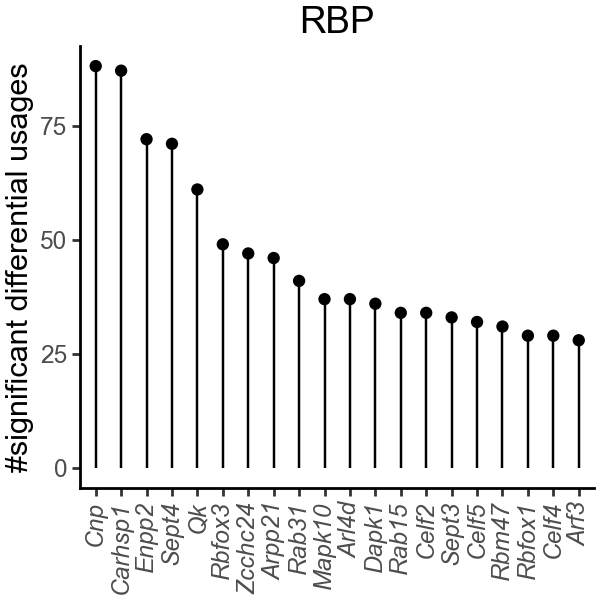

In [82]:
_df = df_du_cbs.reset_index().groupby(['covariate'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index()
_df['covariate'] = pd.Categorical(_df['covariate'], ordered=True, categories=_df['covariate'])

(
    ggplot(_df.head(20), aes(x = 'covariate', y = 'counts')) + 
        geom_point() + 
        geom_segment(aes(x = 'covariate', y = 0, xend = 'covariate', yend = 'counts')) +
        # geom_bar(stat = 'identity') + 
        labs(x = '', y = '#significant differential usages', title = 'RBP') + 
        theme_classic() + 
        theme(
            figure_size=(3, 3),
            text=element_text(family='Arial'),
            axis_text_x=element_text(rotation=90, hjust = 0.5, fontstyle = 'italic')
        )
)

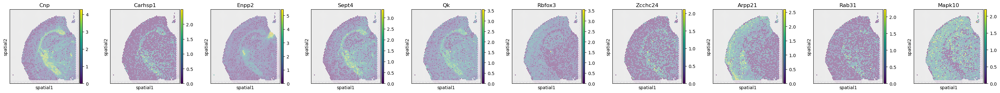

In [83]:
_rbp_to_plot = _df.head(10)['covariate'].to_list()
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_visium_rbp, color = _rbp_to_plot, img_key = 'lowres', alpha_img = 0.3, layer = 'log1p', ncols = len(_rbp_to_plot))

In [84]:
_df = df_du_cbs.copy()
_df.reset_index().loc[_df.reset_index()['covariate'] == 'Qk'].sort_values(
    'pvalue_hsic-gp', ascending=True
).head(15)

,index,gene,covariate,pvalue_hsic,pvalue_hsic-gp,pvalue_glm,pvalue_glmm,is_significant
470196,470196,Sept8,Qk,1.508739e-136,9.003346e-48,0.000000e+00,0.000000e+00,True
512508,512508,Sptbn1,Qk,6.237915e-76,1.859044e-30,0.000000e+00,0.000000e+00,True
81516,81516,Cdc42,Qk,2.680869e-60,3.020138e-27,0.000000e+00,7.549517e-15,True
190740,190740,Gnao1,Qk,1.925257e-64,4.036870e-26,0.000000e+00,0.000000e+00,True
71676,71676,Camta1,Qk,4.563387e-41,8.140768e-23,3.652634e-14,1.368794e-12,True
167124,167124,Fgfr2,Qk,1.794487e-52,8.866029e-22,0.000000e+00,0.000000e+00,True
261588,261588,Map4,Qk,6.772420e-54,1.448333e-17,0.000000e+00,9.225953e-13,True
476100,476100,Sft2d1,Qk,7.469642e-56,8.986743e-16,0.000000e+00,3.330669e-16,True
321612,321612,Ntrk2,Qk,5.930992e-46,5.322476e-15,0.000000e+00,2.355893e-13,True
3780,3780,Actb,Qk,1.365862e-22,9.798325e-15,0.000000e+00,2.715394e-07,True


/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log10


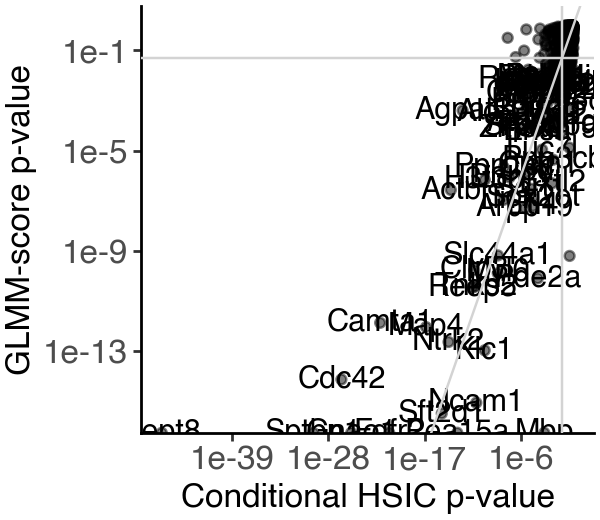

In [85]:
_df = df_du_cbs.reset_index().loc[df_du_cbs.reset_index()['covariate'] == 'Qk', :]
(
    ggplot(_df, aes(y = 'pvalue_glmm', x = 'pvalue_hsic-gp')) +
        geom_point(alpha = 0.5) + 
        geom_text(
            _df.loc[_df['is_significant']],
            aes(label = 'gene')
        ) + 
        geom_hline(yintercept = 0.05, color = 'lightgray') + 
        geom_vline(xintercept = 0.05, color = 'lightgray') + 
        geom_abline(slope = 1, color = 'lightgray') + 
        labs(y = 'GLMM-score p-value', x = 'Conditional HSIC p-value') + 
        scale_x_log10() + 
        scale_y_log10() + 
        theme_classic() + 
        theme(figure_size=[3,2.6],
             text=element_text(size = 12))
)

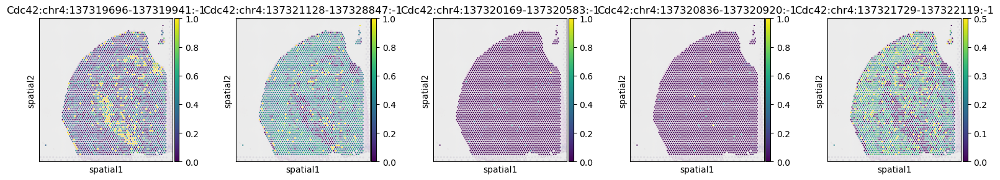

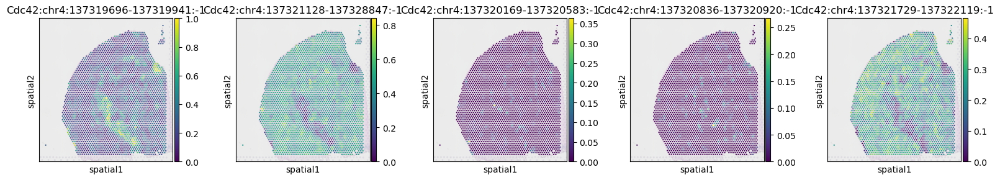

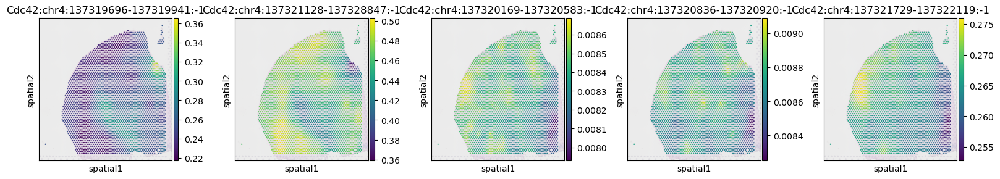

In [86]:
_iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == 'Cdc42']
with plt.rc_context({"figure.figsize": (3, 3)}):
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_obs', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_smoothed', ncols = len(_iso_to_plot))
    sc.pl.spatial(adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img=0.3, layer = 'ratios_glmm', ncols = len(_iso_to_plot))

#### SVS genes with most DU associations

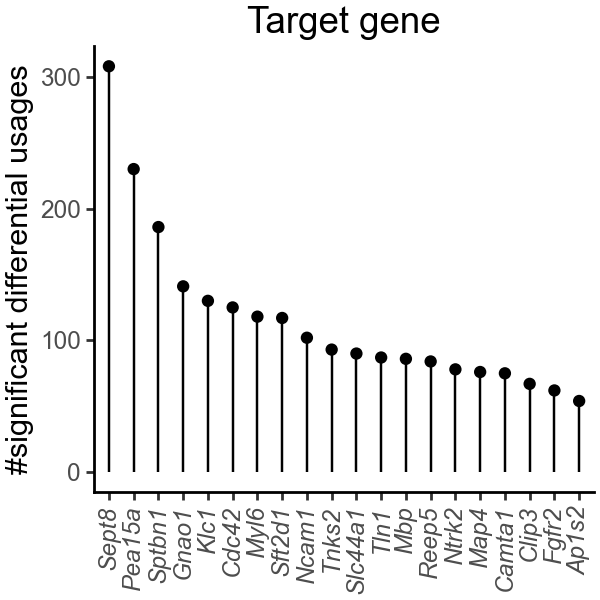

In [87]:
_df = df_du_cbs.reset_index().groupby(['gene'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index()
_df['gene'] = pd.Categorical(_df['gene'], ordered=True, categories=_df['gene'])

(
    ggplot(_df.head(20), aes(x = 'gene', y = 'counts')) + 
        geom_point() + 
        geom_segment(aes(x = 'gene', y = 0, xend = 'gene', yend = 'counts')) +
        # geom_bar(stat = 'identity') + 
        labs(x = '', y = '#significant differential usages', title = 'Target gene') + 
        theme_classic() + 
        theme(
            figure_size=(3, 3),
            text=element_text(family='Arial'),
            axis_text_x=element_text(rotation=90, hjust = 0.5, fontstyle = 'italic')
        )
)

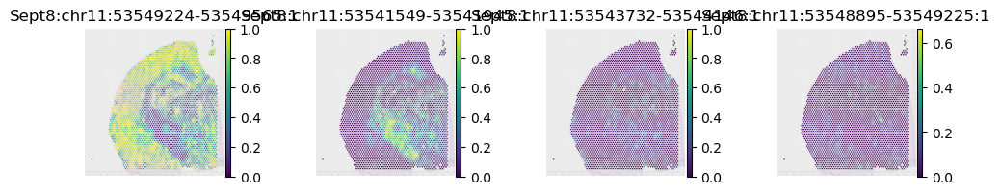

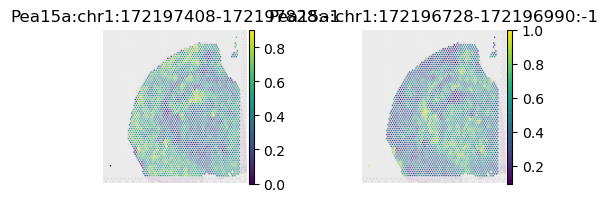

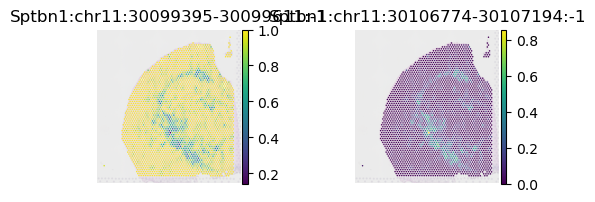

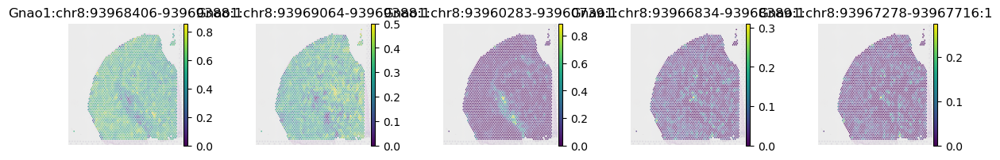

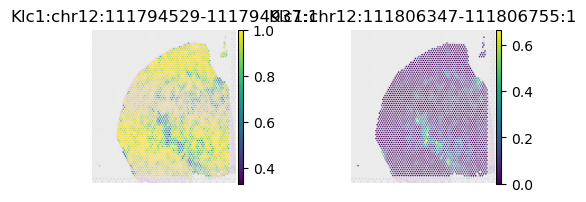

In [88]:
_svs_to_plot = _df.head(5)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

In [89]:
_df = df_du_cbs.copy()
_df.reset_index().loc[_df.reset_index()['gene'] == 'Rps8'].sort_values(
    'pvalue_hsic-gp', ascending=True
).head(15)

,index,gene,covariate,pvalue_hsic,pvalue_hsic-gp,pvalue_glm,pvalue_glmm,is_significant
452122,452122,Rps8,Ddx6,1.015157e-05,0.000036,0.002140,0.003858,True
452612,452612,Rps8,Rab33a,4.841957e-03,0.000052,0.100241,0.047617,False
452152,452152,Rps8,Rbm5,1.543963e-02,0.000063,0.139925,0.106432,False
451866,451866,Rps8,Yars,2.709489e-06,0.000074,0.005141,0.010893,False
452229,452229,Rps8,Npm1,2.200796e-08,0.000084,0.018780,0.046642,False
451882,451882,Rps8,Tardbp,5.312781e-04,0.000174,0.019649,0.021712,False
451767,451767,Rps8,Rbm39,1.703062e-03,0.000186,0.097084,0.109635,False
451980,451980,Rps8,Rab7,4.044309e-04,0.000263,0.503276,0.482158,False
452142,452142,Rps8,Morf4l1,1.133530e-11,0.000288,0.185522,0.263443,False
452551,452551,Rps8,Hars,1.333261e-03,0.000316,0.028521,0.037022,False


#### APA-related RBPs

In [123]:
# the RBPs targeted in https://www.sciencedirect.com/science/article/pii/S0092867424006457?via%3Dihub
df_apa_rbp = pd.read_csv(f'{data_dir}/APA_related_RBP.csv', index_col=0).dropna()

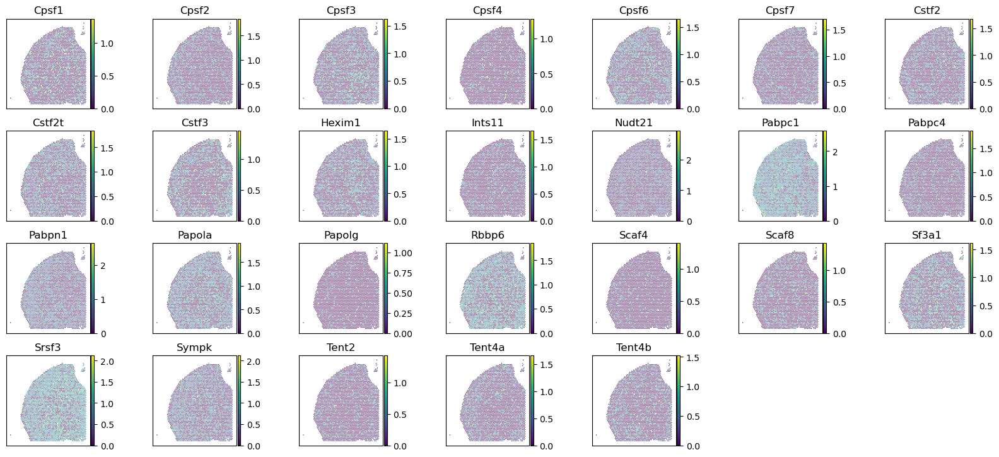

In [137]:
_rbp_to_plots = adata_visium_rbp.var.index[
    adata_visium_rbp.var.index.isin(df_apa_rbp['ortholog_name'])
    # adata_visium_rbp.var.index.isin(['Cnot4', 'Csda']) | 
    # adata_visium_rbp.var_names.str.contains('Ybx') |
    # adata_visium_rbp.var_names.str.contains('Igf2bp')
].sort_values()

with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 7, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, 
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()

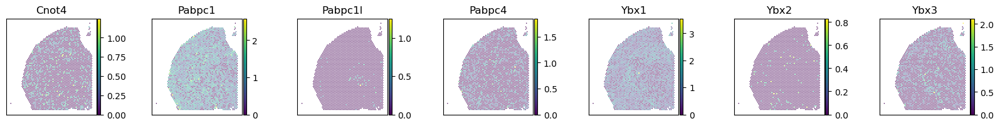

In [138]:
_rbp_to_plots = adata_visium_rbp.var.index[
    adata_visium_rbp.var.index.isin(['Cnot4', 'Csda']) | 
    adata_visium_rbp.var_names.str.contains('Pabpc') |
    adata_visium_rbp.var_names.str.contains('Ybx') |
    adata_visium_rbp.var_names.str.contains('Igf2bp')
].sort_values()

with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 7, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, 
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()

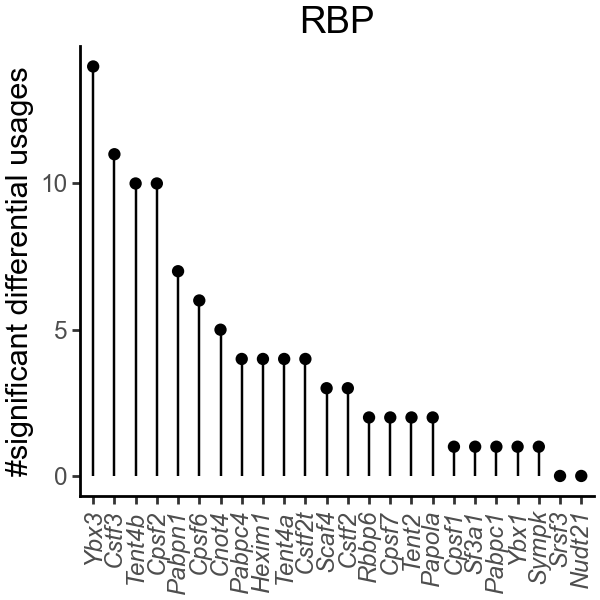

In [132]:
_df = df_du_cbs.reset_index().groupby(['covariate'])['is_significant'].sum().to_frame('counts').sort_values(
    'counts', ascending = False
).reset_index()
_df['rbp'] = pd.Categorical(_df['covariate'], ordered=True, categories=_df['covariate'])

(
    ggplot(
        _df.loc[_df['rbp'].isin(_rbp_to_plots)], 
        aes(x = 'rbp', y = 'counts')
    ) + 
        geom_point() + 
        geom_segment(aes(x = 'rbp', y = 0, xend = 'rbp', yend = 'counts')) +
        # geom_bar(stat = 'identity') + 
        labs(x = '', y = '#significant differential usages', title = 'RBP') + 
        theme_classic() + 
        theme(
            figure_size=(3, 3),
            text=element_text(family='Arial'),
            axis_text_x=element_text(rotation=90, hjust = 0.5, fontstyle = 'italic')
        )
)

#### Self-regulating RBPs
Many due to ambiguous mapping (Akap5 -> As3mt, Ndufs5 -> Zbtb20). Casc3 has peaks in UTR5.

In [106]:
_df = df_du_cbs.loc[df_du_cbs['gene'] == df_du_cbs['covariate']].sort_values(
    # by='pvalue_hsic-gp', 
    by='pvalue_glmm',
    ascending = True
)
_df.head(10)

,gene,covariate,pvalue_hsic,pvalue_hsic-gp,pvalue_glm,pvalue_glmm,is_significant
40300,As3mt,As3mt,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,True
616798,Zbtb20,Zbtb20,6.711675e-208,4.806583e-182,0.000000e+00,0.000000,True
76392,Casc3,Casc3,1.027413e-297,1.547048e-297,0.000000e+00,0.000000,True
435727,Rbfox1,Rbfox1,3.034103e-257,7.473064e-267,0.000000e+00,0.000000,True
38878,Arpp21,Arpp21,5.096426e-26,6.178520e-01,8.264432e-10,0.000004,False
341259,Pcbp2,Pcbp2,3.488503e-40,5.081586e-38,1.895276e-05,0.000022,True
425916,Qk,Qk,9.033455e-07,2.949708e-02,1.496223e-03,0.002177,False
470606,Sept11,Sept11,2.655617e-04,2.055109e-01,1.131523e-02,0.014945,False
328426,Pabpc1,Pabpc1,2.742492e-02,2.388402e-01,1.877633e-01,0.211767,False
334878,Paip2b,Paip2b,1.153534e-04,6.184006e-04,2.154896e-01,0.227314,False


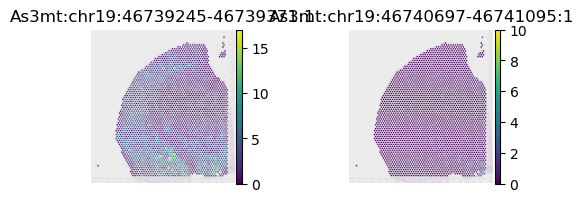

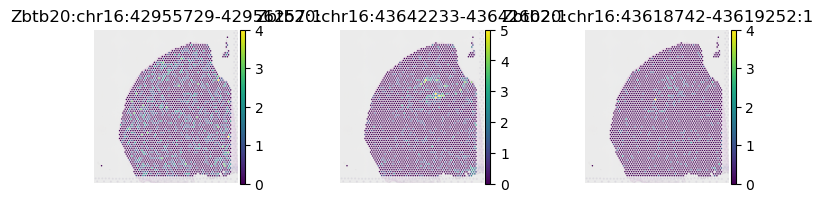

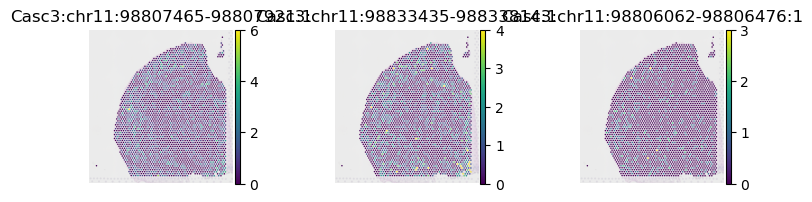

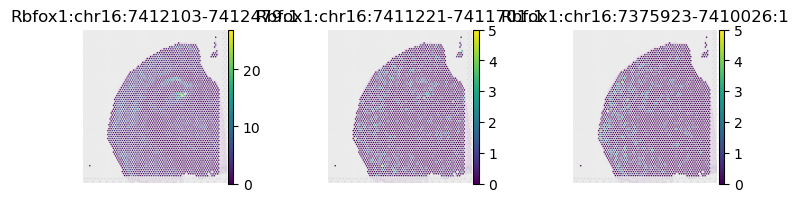

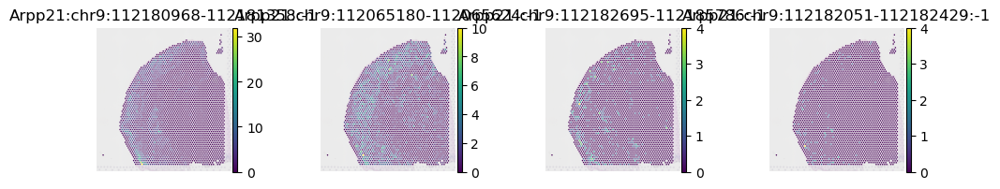

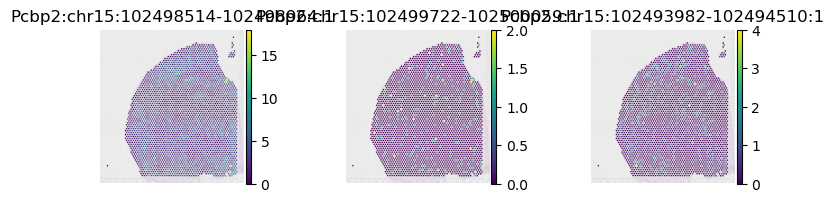

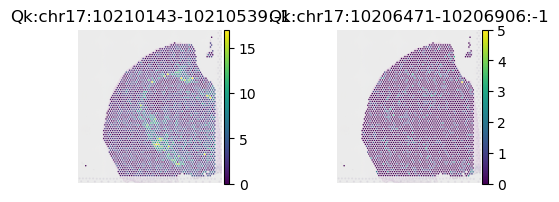

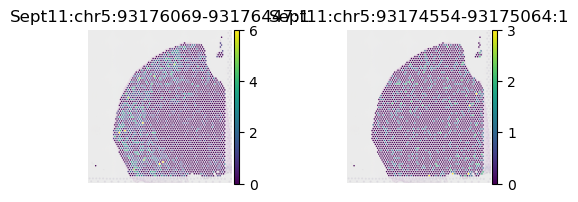

In [107]:
_svs_to_plot = _df.head(8)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'counts', ncols = len(_iso_to_plot),
            frameon=False
        )

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.


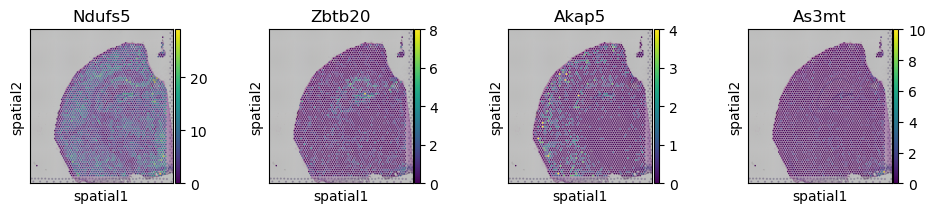

In [227]:
adata_visium = sc.read_10x_h5(f"{data_dir}/Visium_Fresh_Frozen_Adult_Mouse_Brain_filtered_feature_bc_matrix.h5") # short-read gene counts
adata_visium.raw = adata_visium.copy() # raw counts data
adata_visium.var['gene_symbols'] = adata_visium.var_names
adata_visium.var_names_make_unique()
adata_visium = load_visium_sp_meta(adata_visium, f"{data_dir}/visium_spatial_meta", library_id='adata_visium')

with plt.rc_context({"figure.figsize": (2, 2)}):
    sc.pl.spatial(adata_visium, color = ['Ndufs5', 'Zbtb20', 'Akap5', 'As3mt'])

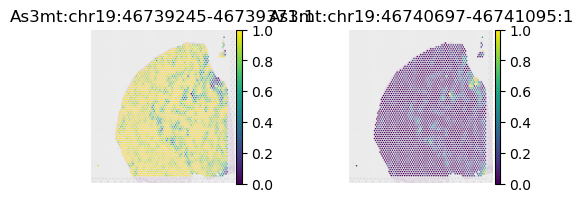

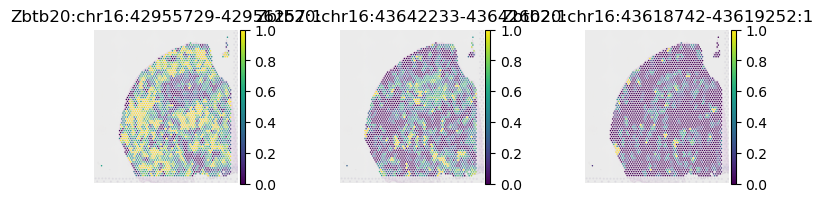

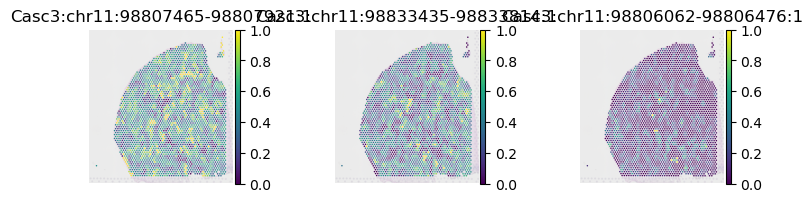

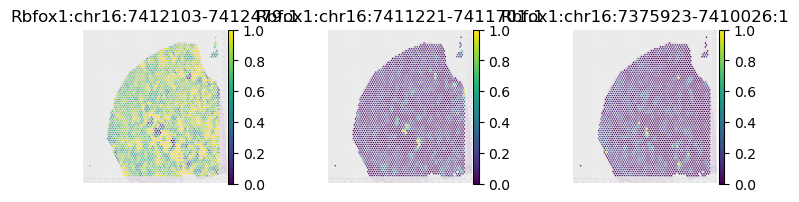

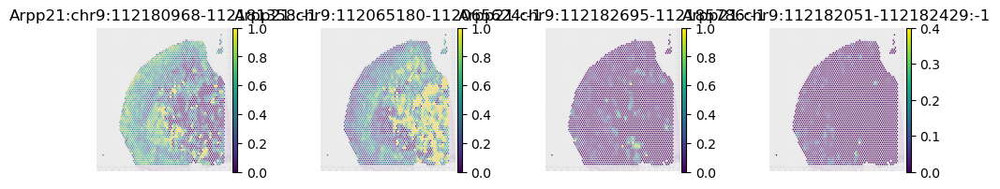

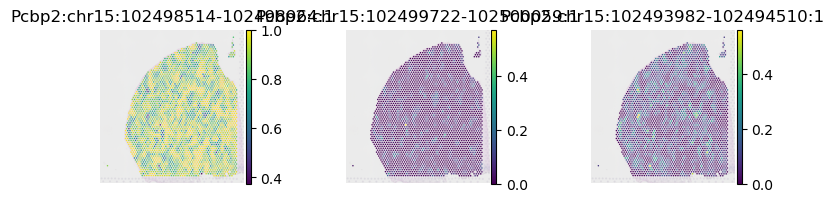

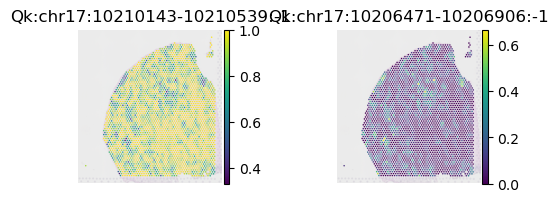

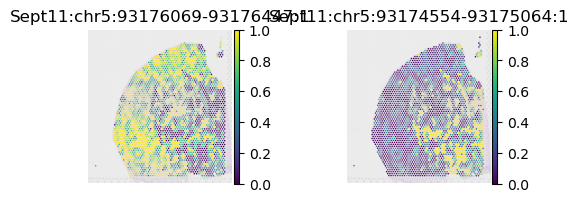

In [108]:
_svs_to_plot = _df.head(8)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

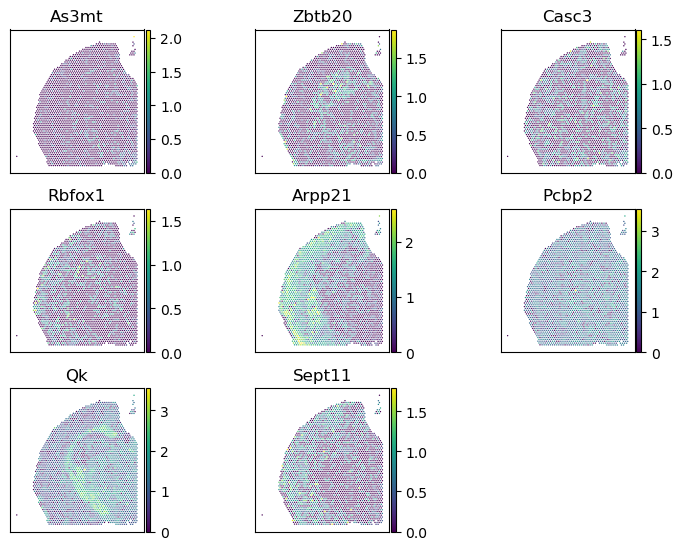

In [109]:
_rbp_to_plots = _df.head(8)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 3, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, 
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()


#### Pcbp2 

In [228]:
_df = pd.DataFrame({
    'visium_count': adata_visium[:,'Pcbp2'].X.toarray().squeeze(),
    'peak1': adata_peak_sv[:, 'Pcbp2:chr15:102493982-102494510:1'].layers['counts'].toarray().squeeze(),
    'peak2': adata_peak_sv[:, 'Pcbp2:chr15:102498514-102498964:1'].layers['counts'].toarray().squeeze(),
    'peak3': adata_peak_sv[:, 'Pcbp2:chr15:102499722-102500059:1'].layers['counts'].toarray().squeeze() 
})

/Users/jysumac/miniforge3/envs/isosde/lib/python3.12/site-packages/plotnine/layer.py:364: PlotnineWarning: geom_point : Removed 205 rows containing missing values.


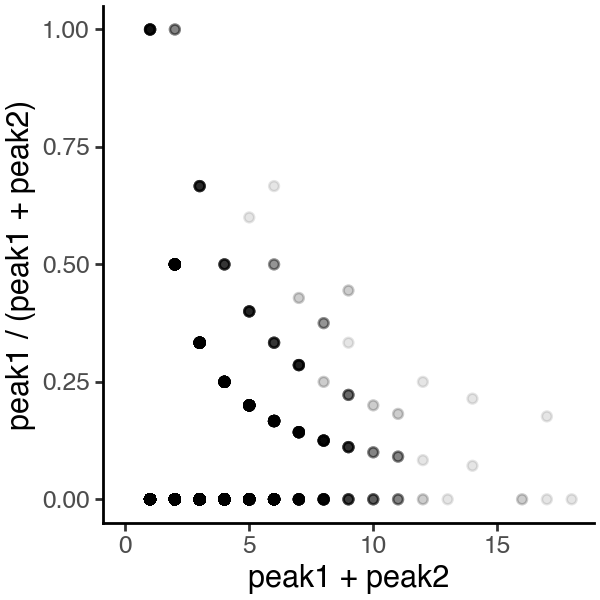

In [229]:
(
    ggplot(_df, aes(
        y = 'peak1 / (peak1 + peak2)', 
        x = 'peak1 + peak2',
        # x = 'peak1 + peak2 + peak3', 
        # y = 'visium_count'
    )) + 
        geom_point(alpha = 0.1) + 
        theme_classic() + 
        theme(figure_size=[3,3])
)

#### RBP themselves variably spliced

In [262]:
# select list of RBP to focus on
_rbp_list = ['Celf5', 'Arpp21', 'Adar', 'Adarb1', 'Adarb2'] + \
    _rbp_has_clip + _rbp_has_motif

_df = df_sv_cbs.loc[
    df_sv_cbs.index.isin(_rbp_list) & df_sv_cbs['is_trend_expressed'] & df_sv_cbs['is_trend_svs']
].reset_index()
_df.head(20)

,gene,n_iso,pct_spot_on,count_avg,count_std,perplexity,major_ratio_avg,pvalue_hsic-ir,padj_hsic-ir,pvalue_hsic-ic,padj_hsic-ic,pvalue_hsic-gc,padj_hsic-gc,pvalue_spark-x,padj_spark-x,is_trend_svs,is_trend_sve,is_trend_expressed
0,Celf2,6,0.799070,2.338219,2.110129,4.736917,0.341131,7.110088e-126,2.515549e-123,2.432872e-278,9.255376e-277,1.261496e-161,1.229525e-160,1.239197e-62,1.917831e-60,True,True,True
1,Arpp21,4,0.703611,2.658920,3.412558,2.511989,0.556542,2.160291e-107,5.459364e-105,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.931130e-157,3.320772e-154,True,True,True
2,Elavl2,3,0.538792,1.003575,1.262190,1.651337,0.857855,6.140829e-28,2.151114e-26,7.996654e-144,6.058279e-143,6.275733e-120,3.552567e-119,5.150773e-22,1.512627e-20,True,True,True
3,Zcrb1,2,0.799785,1.920629,1.609809,1.331809,0.916791,1.253586e-12,2.122099e-11,1.297701e-63,3.907459e-63,8.091673e-59,2.288436e-58,1.943644e-19,5.059820e-18,True,True,True
4,Celf1,2,0.629603,1.204147,1.326881,1.393316,0.896972,5.787911e-12,9.258214e-11,8.880143e-73,2.997895e-72,6.731002e-88,2.724746e-87,7.001553e-27,2.546624e-25,True,True,True
5,Pabpc1,2,0.787272,1.748302,1.535052,1.799705,0.725562,8.494197e-11,1.246990e-09,1.694682e-49,4.189926e-49,9.374734e-54,2.435228e-53,2.553513e-15,5.227407e-14,True,True,True
6,Celf4,4,0.730068,2.202002,2.239572,3.270138,0.410943,2.384215e-10,3.307982e-09,2.090531e-201,3.018898e-200,1.966423e-175,2.258832e-174,3.437370e-54,3.911627e-52,True,True,True
7,Hnrnpa2b1,2,0.952092,4.372542,3.153209,1.648075,0.800572,7.995562e-09,8.785186e-08,9.732256e-103,4.603305e-102,5.261258e-108,2.629143e-107,6.849324e-41,4.598824e-39,True,True,True
8,Qk,2,0.892385,3.017519,2.577101,1.319129,0.920735,1.943319e-08,2.037526e-07,8.608580e-153,7.374614e-152,2.138712e-145,1.715820e-144,4.834365e-34,2.457096e-32,True,True,True
9,Ybx1,2,0.778691,1.838756,1.685951,1.503462,0.858448,1.472048e-07,1.377806e-06,5.098372e-48,1.229587e-47,3.402790e-49,8.178718e-49,9.588108e-12,1.565289e-10,True,True,True


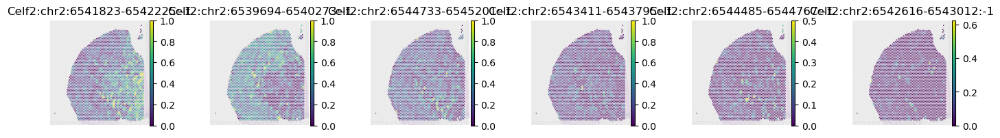

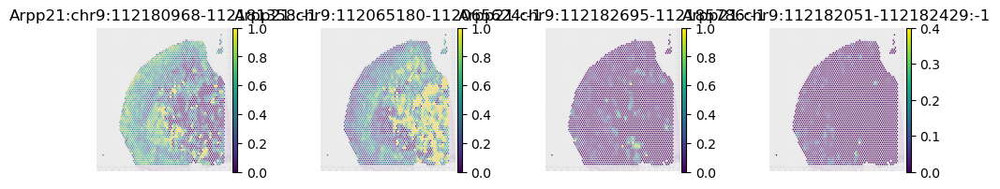

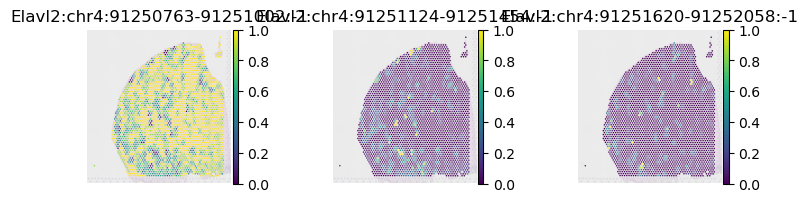

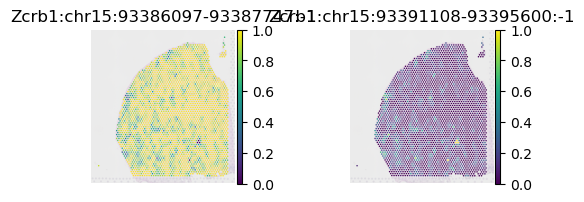

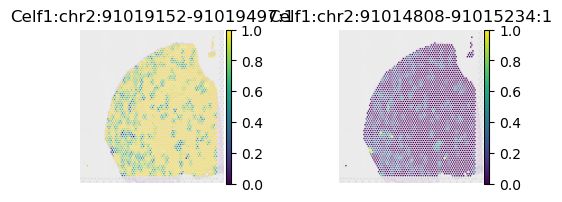

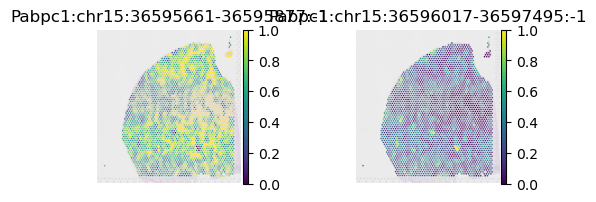

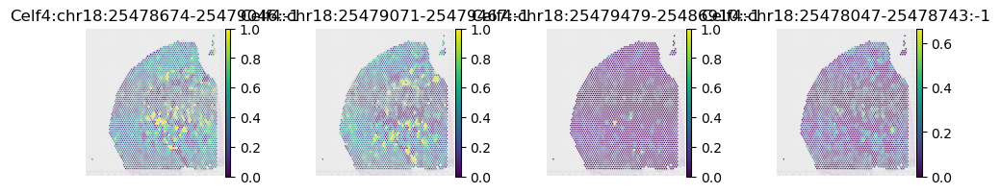

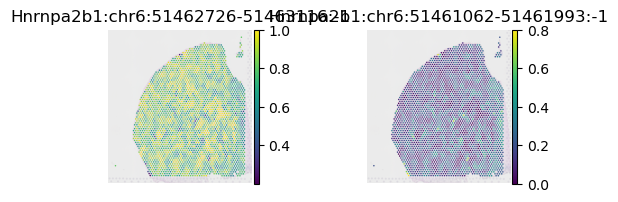

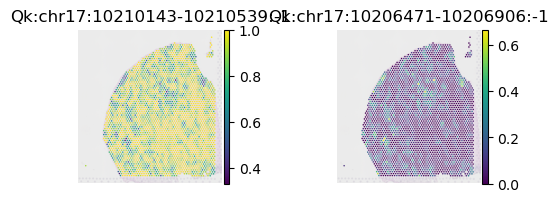

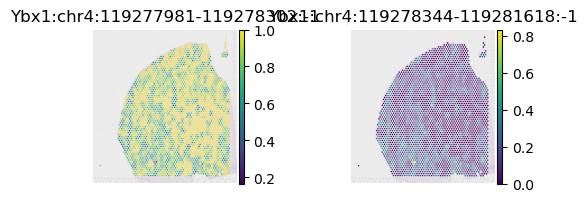

In [267]:
_svs_to_plot = _df.head(10)['gene'].to_list()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

### Plot RBP expression

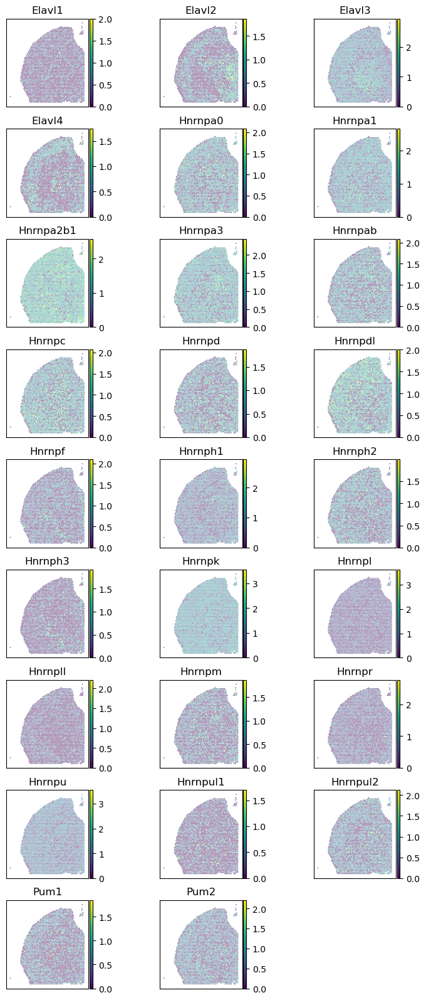

In [5]:
_rbp_to_plots = adata_visium_rbp.var_names[
    adata_visium_rbp.var_names.str.contains('Hnrnp') |
    adata_visium_rbp.var_names.str.contains('Elavl')
].sort_values().to_list() + ['Pum1', 'Pum2']
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 3, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, 
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()


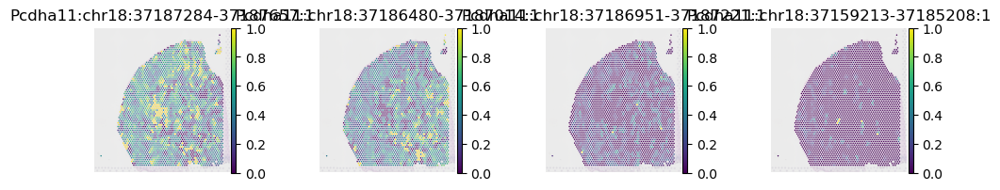

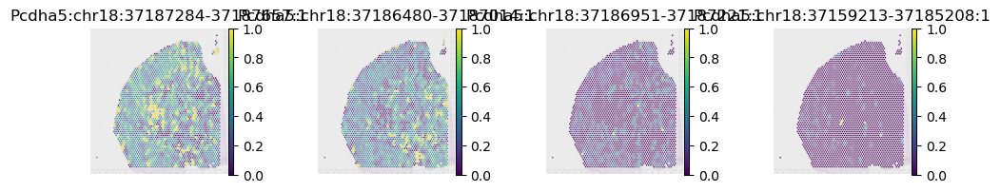

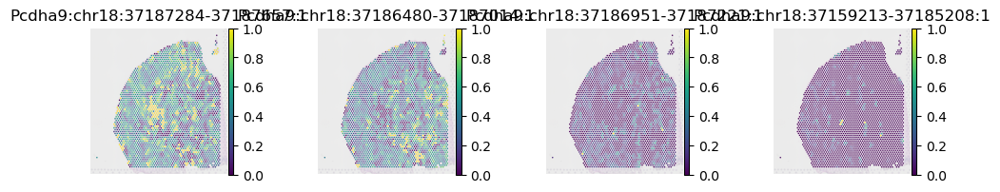

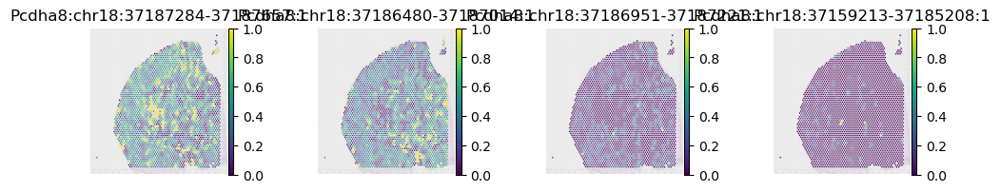

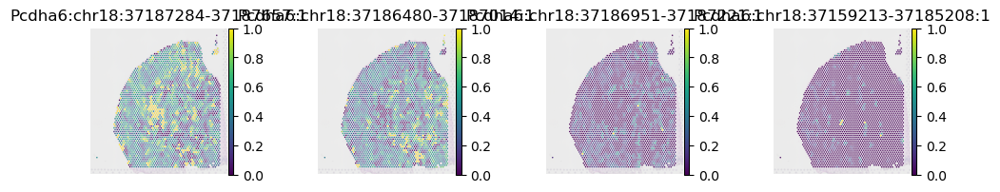

...

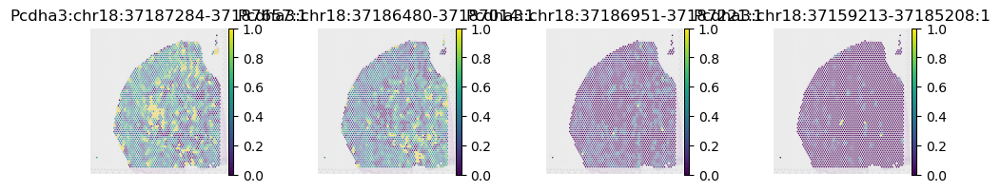

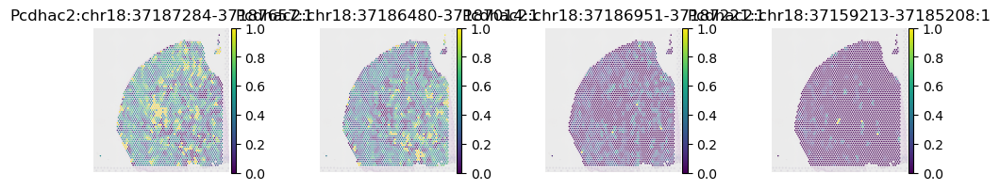

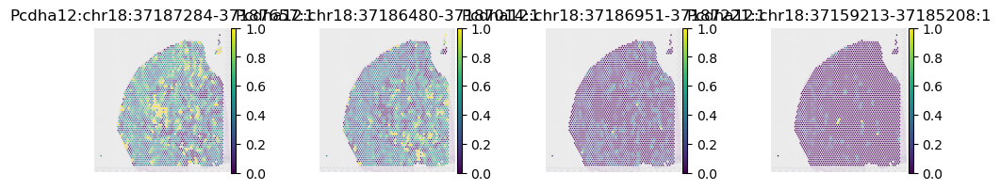

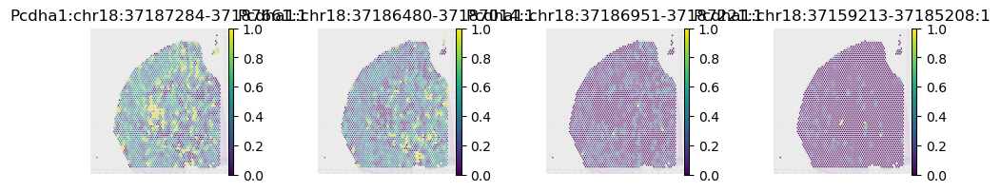

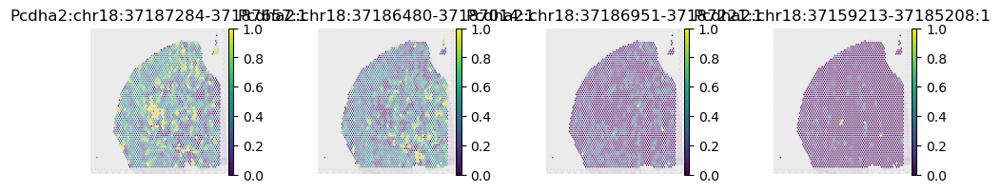

In [6]:
_svs_to_plot = adata_peak_sv.var['gene_symbol'][adata_peak_sv.var['gene_symbol'].str.contains('Pcdha')].unique()
with plt.rc_context({"figure.figsize": (2, 2)}):
    for _gene in _svs_to_plot:
        _iso_to_plot = adata_peak_sv.var.index[adata_peak_sv.var['gene_symbol'] == _gene]
        sc.pl.spatial(
            adata_peak_sv, color = _iso_to_plot, img_key = 'lowres', alpha_img = 0.3, 
            layer = 'ratios_smoothed', ncols = len(_iso_to_plot),
            frameon=False
        )

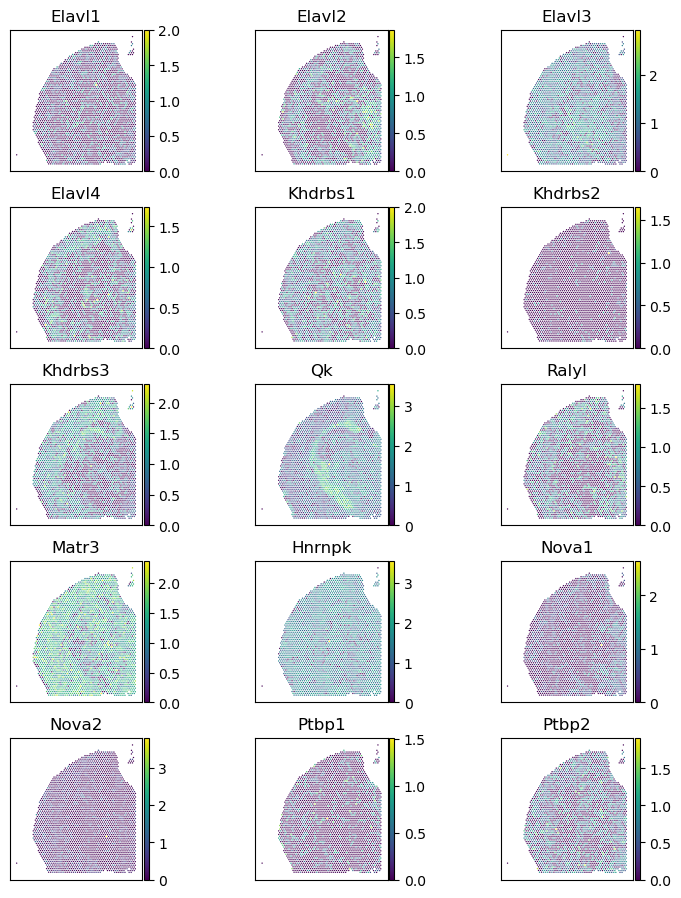

In [10]:
_rbp_to_plots = adata_visium_rbp.var_names[
    adata_visium_rbp.var_names.str.contains('Khdrbs') |
    adata_visium_rbp.var_names.str.contains('Elavl')
].sort_values().to_list() + ['Qk', 'Ralyl', 'Matr3', 'Hnrnpk'] + ['Nova1', 'Nova2', 'Ptbp1', 'Ptbp2']
with plt.rc_context({"figure.figsize": (2, 2)}):
    axes = sc.pl.spatial(
        adata_visium_rbp, color = _rbp_to_plots, 
        ncols = 3, layer = 'log1p',
        img_key = 'lowres', alpha_img=0.0, 
        frameon = True, show = False)

    for _ax in axes:
        _ax.set_xlabel('')
        _ax.set_ylabel('')

    plt.show()

## Save source data of main figures for visualization in R

### SV test results

In [41]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"

import os
if not os.path.exists(f"{res_dir}/figures/source_data/"):
    os.makedirs(f"{res_dir}/figures/source_data/")

#### Save functional enrichment results

In [39]:
# functional enrichment results
df_go.to_csv(f"{res_dir}/figures/source_data/go_top20.csv", index = False)
df_kegg.to_csv(f"{res_dir}/figures/source_data/kegg_top20.csv", index = False)
df_reac.to_csv(f"{res_dir}/figures/source_data/reac_top20.csv", index = False)

#### Save clustering results

In [44]:
# Clustering results
df_clu = adata_peak_sv.obs[['array_row', 'array_col', 'clu_trend_sve', 'clu_trend_svs', 'clu_visium_rbp_sve']]
df_clu.to_csv(f"{res_dir}/figures/source_data/clu_res.csv")

### DU test results

In [123]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"

df_du_cbs.to_csv(f"{res_dir}/figures/source_data/du_res_annot.csv", index = False)

#### Save RBP expression

In [9]:
# save RBP expression per spot
_rbp_to_save = [f'Rbfox{i+1}' for i in range(3)] + \
    [f'Celf{i+1}' for i in range(6)] + ['Qk', 'Khdrbs3'] + \
    ['Cstf3', 'Tent4b', # APA-based
     'Zfp36l1', 'Zfp36l2', 'Pabpc4', # motif-based
     'Pcbp2', 'Arpp21', 'Elavl2', 'Elavl3', 'Hnrnpa2b1', 'Hnrnpk', 'Pabpc1', 'Pabpn1', # SVS RBPs
     'Rbm24', 'Rbms3', # potential regulators
     "Matr3", "G3bp2", "Hnrnph1", "Adar", "Elavl2", "Ralyl", "Hnrnpf",
     'Nova1', 'Nova2', 'Ptbpc2'
    ]

_rbp_to_save = adata_visium_rbp.var_names[
    adata_visium_rbp.var_names.isin(_rbp_to_save)
].to_list()

df_rbp_expr = []
for _layer in ['log1p', 'counts']:
    df_expr = adata_peak_sv.obs[['array_row', 'array_col']].reset_index(names = 'barcode')
    for _rbp in _rbp_to_save:
        df_expr[_rbp] = adata_visium_rbp[df_expr['barcode'], _rbp].layers[_layer].toarray().squeeze()

    df_expr = df_expr.melt(id_vars=['barcode', 'array_row', 'array_col'], 
                           var_name='gene', value_name='expression')
    df_expr['layer'] = _layer
    df_rbp_expr.append(df_expr)

df_rbp_expr = pd.concat(df_rbp_expr, axis = 0)
df_rbp_expr.to_csv(f"{res_dir}/figures/source_data/rbp_expr.csv", index = False)

#### Save isoform usage

In [12]:
## save isoform usage per spot
# SVS RBPs
_rbp_list = ['Celf5', 'Arpp21', 'Adar', 'Adarb1', 'Adarb2'] + \
    _rbp_has_clip + _rbp_has_motif
_svs_rbp = df_sv_cbs.loc[
    df_sv_cbs.index.isin(_rbp_list) & df_sv_cbs['is_trend_expressed'] & df_sv_cbs['is_trend_svs']
].index.to_list()

# Neuronal APAs
_svs_neuron = ['Itsn1', 'Map4', 'Atp2a2', 'Klc1', 'Cdc42']

# other CDS changes
_svs_cds = ['Sept8', 'Sept11', 'Hsp90aa1', 'Hsp90ab1', 'Olfm1', 'Kalrn', 'Rexo2', 'Ppp2r5c', 'Ap1s2', 'Lgi3']

# Potential coregulated Rbfox3 targets
_svs_rbfox = ['Gnao1', 'Tln1', 'Klc1']

_svs_to_save = list(set(_svs_rbp + _svs_neuron + _svs_cds + _svs_rbfox))

df_svs_ratio = []
for _layer in ['counts', 'log1p', 'ratios_obs', 'ratios_smoothed', 'ratios_glmm']:
    df_layer = []
    # loop over SVS genes
    for _svs in _svs_to_save:
        df_svs = adata_peak_sv.obs[['array_row', 'array_col']].reset_index(names = 'barcode')
        _iso_list = adata_peak_sv.var_names[adata_peak_sv.var['gene_symbol'] == _svs]
        for _iso in _iso_list:
            df_svs[_iso] = adata_peak_sv[df_svs['barcode'], _iso].layers[_layer].toarray().squeeze()
        df_svs = df_svs.melt(id_vars=['barcode', 'array_row', 'array_col'], 
                             var_name='isoform', value_name='ratio')
        df_svs['gene'] = _svs
        df_layer.append(df_svs)

    # concatenate all genes
    df_layer = pd.concat(df_layer, axis = 0)
    df_layer['layer'] = _layer
    df_svs_ratio.append(df_layer)

df_svs_ratio = pd.concat(df_svs_ratio, axis = 0)
df_svs_ratio.to_csv(f"{res_dir}/figures/source_data/svs_ratio.csv", index = False)

### Sequence feature analysis

In [58]:
adata_peak_sv.var['strand'].value_counts()

strand
1     1048
-1     796
Name: count, dtype: int64

#### Save SVS genes

In [26]:
res_dir = "/Users/jysumac/Projects/SPLISOSM_paper/results/visium_mouse_cbs/"

import os
if not os.path.exists(f"{res_dir}/events/"):
    os.makedirs(f"{res_dir}/events/")

df_sv_cbs = pd.read_csv(f"{res_dir}/sv_results/cbs_peak_sv_combined_{date}.csv", index_col=0)

# define significant events
df_sv_cbs['is_trend_svs'] = df_sv_cbs['padj_hsic-ir'] < 0.01
df_sv_cbs['is_trend_sve'] = df_sv_cbs['padj_hsic-gc'] < 0.01
df_sv_cbs['is_trend_expressed'] = df_sv_cbs['count_avg'] > 0.5

_df = df_sv_cbs.copy()

# save SVS gene symbols
_df.index[_df['is_trend_svs']].to_frame().to_csv(
    f"{res_dir}/events/cbs_svs.gene_symbol.txt", sep="\t", header=False, index=False
)

#### Save SV events

In [45]:
# load Sierra peak coordinates
peak_all = pd.read_table(f"{data_dir}/peak_no_cutoff.txt", index_col=False)

# Function to parse exon positions
def parse_exon_positions(row):
    peak_start = row["Fit.start"]
    peak_end = row["Fit.end"]
    
    if row["exon.intron"] == 'no-junctions':
        block_sizes = [peak_end - peak_start]
        block_starts = [0]
    else:
        # Extract the exon positions from the `exon.pos` column
        exon_positions = row["exon.pos"]
        
        # Clean and split the positions into tuples
        positions = exon_positions.split(')(')
        exons = [tuple(map(int, pos.replace('(', '').replace(')', '').split(","))) for pos in positions]

        # update the first and last exon
        exons[0] = (peak_start, exons[0][1])
        exons[-1] = (exons[-1][0], peak_end)
        
        # Calculate block sizes and block starts
        block_sizes = [end - start for start, end in exons]
        block_starts = [start - peak_start for start, _ in exons]

        # Make sure that blocks all have >0 length
        # ('Gm20390:chr11:93949819-93951900:-1' has an exon of length 0, probably annotation error)
        block_sizes_cleaned = [size for size in block_sizes if size > 0]
        block_starts_cleaned = [start for size, start in zip(block_sizes, block_starts) if size > 0]

        block_sizes, block_starts = block_sizes_cleaned, block_starts_cleaned
        
    return block_sizes, block_starts

In [46]:
adata_peak = sc.read_h5ad(f"{res_dir}/anndata/cbs_peak_filtered_{date}.h5ad")

# Save peaks of SVS genes
# Save peaks of SVE but not SVS genes
svs_idx = adata_peak.var['gene_symbol'].isin(_df.index[_df['is_trend_svs']])
df = peak_all.set_index('polyA_ID').loc[adata_peak.var_names[svs_idx]].reset_index(names = 'polyA_ID')
df[["blockSizes", "blockStarts"]] = df.apply(
    lambda row: pd.Series(parse_exon_positions(row)), axis=1
)

# Create a BED12 DataFrame
bed12_df = pd.DataFrame({
    "chrom": df["Chr"],
    "chromStart": df["Fit.start"],
    "chromEnd": df["Fit.end"],
    "name": df["polyA_ID"],
    "score": 0,  # Default score
    "strand": df["Strand"].map({1: "+", -1: "-"}),  # Convert strand to "+" or "-"
    "thickStart": df["Fit.start"],  # Use full region for thick display
    "thickEnd": df["Fit.end"],
    "itemRgb": "0",  # Default black color
    "blockCount": df["blockSizes"].apply(len),
    "blockSizes": df["blockSizes"].apply(lambda x: ",".join(map(str, x))),
    "blockStarts": df["blockStarts"].apply(lambda x: ",".join(map(str, x))),
})

bed12_df = bed12_df.drop_duplicates(["chrom", "chromStart", "chromEnd", "strand"])

# Save to BED12 format (tab-separated)
print(f"Saving {len(bed12_df)} peaks of {df['Gene'].nunique()} SVS genes.")
bed12_df.to_csv(f"{res_dir}/events/cbs_svs.exon.bed", sep="\t", index=False, header=False)

Saving 2237 peaks of 815 SVS genes.


In [47]:
peak_all.loc[peak_all['polyA_ID'] == 'Gm20390:chr11:93949819-93951900:-1']

,Gene,Chr,Strand,MaxPosition,Fit.max.pos,Fit.start,Fit.end,mu,sigma,k,exon.intron,exon.pos,LogLik,polyA_ID
16072,Gm20390,chr11,-1,93949979,93949842,93949819,93951900,163.228517,68.864642,26357.979815,across-junctions,"(93949819,93950045)(93951900,93951900)",-3635.24795,Gm20390:chr11:93949819-93951900:-1


In [48]:
bed12_df.loc[bed12_df['name'] == 'Gm20390:chr11:93949819-93951900:-1']

,chrom,chromStart,chromEnd,name,score,strand,thickStart,thickEnd,itemRgb,blockCount,blockSizes,blockStarts
615,chr11,93949819,93951900,Gm20390:chr11:93949819-93951900:-1,0,-,93949819,93951900,0,1,226,0


In [49]:
adata_peak = sc.read_h5ad(f"{res_dir}/anndata/cbs_peak_filtered_{date}.h5ad")

# Save peaks of SVE but not SVS genes
svens_idx = adata_peak.var['gene_symbol'].isin(_df.index[(~ _df['is_trend_svs']) & _df['is_trend_sve']])
df = peak_all.set_index('polyA_ID').loc[adata_peak.var_names[svens_idx]].reset_index(names = 'polyA_ID')
df[["blockSizes", "blockStarts"]] = df.apply(
    lambda row: pd.Series(parse_exon_positions(row)), axis=1
)

# Create a BED12 DataFrame
bed12_df = pd.DataFrame({
    "chrom": df["Chr"],
    "chromStart": df["Fit.start"],
    "chromEnd": df["Fit.end"],
    "name": df["polyA_ID"],
    "score": 0,  # Default score
    "strand": df["Strand"].map({1: "+", -1: "-"}),  # Convert strand to "+" or "-"
    "thickStart": df["Fit.start"],  # Use full region for thick display
    "thickEnd": df["Fit.end"],
    "itemRgb": "0",  # Default black color
    "blockCount": df["blockSizes"].apply(len),
    "blockSizes": df["blockSizes"].apply(lambda x: ",".join(map(str, x))),
    "blockStarts": df["blockStarts"].apply(lambda x: ",".join(map(str, x))),
})

bed12_df = bed12_df.drop_duplicates(["chrom", "chromStart", "chromEnd", "strand"])

# Save to BED12 format (tab-separated)
print(f"Saving {len(bed12_df)} peaks of {df['Gene'].nunique()} SVENS genes.")
bed12_df.to_csv(f"{res_dir}/events/cbs_svens.exon.bed", sep="\t", index=False, header=False)

Saving 6139 peaks of 2693 SVENS genes.
